# Introduzione
Questo progetto ha l’obiettivo di sviluppare un sistema avanzato per analizzare e prevedere l’esito dei round di gioco nel celebre sparatutto in prima persona **Counter-Strike: Global Offensive (CS:GO)**. Attraverso l’utilizzo di tecniche di apprendimento automatico, inferenza probabilistica e basi di conoscenza, l’analisi si concentrerà sui dati raccolti durante le partite competitive per fornire insight predittivi e strategici.

---

## Cos'é CS:GO?
**Counter-Strike: Global Offensive (CS:GO)** è uno sparatutto tattico a squadre in cui due team, i **Contro-Terroristi (CT)** e i **Terroristi (T)**, si affrontano in una serie di round. La modalità di gioco principale è **Bomb Defusal**, in cui il team Terrorista tenta di piazzare una bomba in uno dei siti designati, mentre i Contro-Terroristi cercano di impedirglielo o di disinnescare la bomba qualora venga piazzata.

### Composizione delle Squadre
Ogni squadra è composta da **5 giocatori**, per un totale di **10 partecipanti**. Le squadre competono in una partita al meglio di **30 round**: la prima squadra che ne vince **16** si aggiudica la vittoria. Ogni round dura al massimo **1 minuto e 55 secondi**.

- **Contro-Terroristi (CT)**: Proteggono i siti A e B dove i Terroristi possono piazzare la bomba. Hanno l'obiettivo di prevenire il piazzamento o disinnescare la bomba una volta attivata.
- **Terroristi (T)**: Devono piazzare la bomba in uno dei due siti e proteggerla fino all'esplosione (40 secondi), oppure eliminare tutti i Contro-Terroristi.

### Mappe di Gioco
Le partite si svolgono su una delle **7 mappe disponibili**, ognuna con layout unico che influisce sulle strategie adottabili.

### Fasi della Partita
- Una squadra inizia come Contro-Terroristi e l’altra come Terroristi. Dopo 15 round, le squadre scambiano i ruoli.
- Ogni round inizia con una fase chiamata **Freeze Time**, in cui i giocatori possono eventualmente spendere i crediti guadagnati nei round precedenti per equipaggiarsi. I tipi di acquisti variano a seconda delle strategie e del budget disponibile:
    - **Full Buy**: Acquisto completo di armi, armature, e utility (granate, kit di disinnesco).
    - **Force Buy**: Massimo acquisto possibile per le risorse limitate.
    - **Eco Round**: Risparmio intenzionale per accumulare risorse nei round successivi.
    
    Questa dinamica aggiunge un elemento di gestione economica che influisce sulle decisioni tattiche dei team.
- Il round si sviluppa in una serie di azioni tattiche fino al raggiungimento di uno degli obiettivi.
- Se la partita non si decide nei 30 round, si va ai **round di Overtime**.

---

## Dataset
Il dataset utilizzato é stato creato da Christian Lillelund e può essere scaricato da [Kaggle](https://www.kaggle.com/christianlillelund/csgo-round-winner-classification).
Il dataset è stato originariamente pubblicato da **Skybox** come parte del loro **CS:GO AI Challenge**, un evento che si è svolto dalla primavera all'autunno del 2020. I dati raccolti derivano da circa **700 demo** di partite giocate in tornei di alto livello negli anni **2019 e 2020**. 

### Caratteristiche del Dataset
1. **Filtraggio dei dati**:
   - Sono stati esclusi i round di riscaldamento (*warmup*) e i riavvii.
   - I dati si concentrano esclusivamente sui round attivi (*live rounds*).

2. **Struttura dei dati**:
   - Per ogni round attivo, è stato registrato uno snapshot ogni **20 secondi** fino alla conclusione del round.
   - I dati includono **122.411 snapshot** totali.

3. **Pre-elaborazione**:
   - Il dataset è stato pre-processato e appiattito per migliorare la leggibilità e facilitarne l’uso da parte degli algoritmi.

### Data Dictionary

Il dataset è costituito da snapshot indipendenti e identicamente distribuiti (*i.i.d.*), ciascuno dei quali descrive lo stato di un round specifico. È importante notare che:
- Ogni snapshot può essere trattato individualmente.
- Più snapshot possono derivare dallo stesso round, ma rappresentano momenti diversi.

| Variabile          | Definizione                                             | Note                                        |
|--------------------|---------------------------------------------------------|---------------------------------------------|
| `time_left`        | Tempo rimanente nel round corrente.                     | Misurato in secondi.                        |
| `ct_score`         | Punteggio attuale del team Contro-Terroristi.           |                                             |
| `t_score`          | Punteggio attuale del team Terroristi.                  |                                             |
| `map`              | Mappa su cui si gioca il round.                         | Es.: *de_dust2*, *de_inferno*.              |
| `bomb_planted`     | Stato della bomba (piazzata o no).                      | *False* = No, *True* = Sì.                  |
| `ct_health`        | Salute totale dei giocatori Contro-Terroristi.          | Valore per ogni giocatore: 0-100.           |
| `t_health`         | Salute totale dei giocatori Terroristi.                 | Valore per ogni giocatore: 0-100.           |
| `ct_armor`         | Armatura totale dei giocatori Contro-Terroristi.        | Valore per ogni giocatore: 0-100.           |
| `t_armor`          | Armatura totale dei giocatori Terroristi.               | Valore per ogni giocatore: 0-100.           |
| `ct_money`         | Totale del denaro del team Contro-Terroristi.           | Valore in USD.                              |
| `t_money`          | Totale del denaro del team Terroristi.                  | Valore in USD.                              |
| `ct_helmets`       | Numero di elmetti nel team Contro-Terroristi.           | Valori possibili: 0-5.                      |
| `t_helmets`        | Numero di elmetti nel team Terroristi.                  | Valori possibili: 0-5.                      |
| `ct_defuse_kits`   | Numero di kit di disinnesco nel team Contro-Terroristi. | Valori possibili: 0-5.                      |
| `ct_players_alive` | Numero di giocatori Contro-Terroristi vivi.             | Valori possibili: 0-5.                      |
| `t_players_alive`  | Numero di giocatori Terroristi vivi.                    | Valori possibili: 0-5.                      |
| `ct_weapon_X`      | Numero di armi di tipo X nel team Contro-Terroristi.    | Es.: *AK-47*, *Deagle*, *UMP-45*.           |
| `t_weapon_X`       | Numero di armi di tipo X nel team Terroristi.           | Es.: *AK-47*, *Deagle*, *UMP-45*.           |
| `ct_grenade_X`     | Numero di granate di tipo X nel team Contro-Terroristi. | Es.: *HeGrenade*, *Flashbang*.              |
| `t_grenade_X`      | Numero di granate di tipo X nel team Terroristi.        | Es.: *HeGrenade*, *Flashbang*.              |
| `round_winner`     | Vincitore del round.                                    | *CT* = Contro-Terroristi, *T* = Terroristi. |

L'obiettivo del sistema è prevedere l'etichetta **`round_winner`** (vincitore del round) basandosi sulle caratteristiche di ciascun snapshot.

---

## Fonti e risorse aggiuntive

- **Skybox Website**: [Skybox](https://skybox.gg/)
- **Informazioni su CS:GO**: [Wikipedia](https://en.wikipedia.org/wiki/Counter-Strike:_Global_Offensive)
- **CS:GO su Steam Store**: [Steam Store](https://store.steampowered.com/app/730/CounterStrike_Global_Offensive/)
- **Approfondimenti su CS:GO competitivo**: [HLTV](https://www.hltv.org/)

---

# Importazione delle dipendenze

In [166]:
import math

import numpy as np
import pandas as pd
import plotly.express as px
import seaborn as sns
import xgboost as xg
from kneed import KneeLocator
from matplotlib import pyplot as plt
from sklearn import preprocessing
from sklearn.cluster import KMeans
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, f1_score, precision_score, confusion_matrix, recall_score, log_loss
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
from sklearn.model_selection import learning_curve
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.neighbors import KNeighborsClassifier
from skopt import BayesSearchCV
from sklearn.feature_selection import SelectKBest, SelectFromModel

In [44]:
# Variabili e funzioni utili
color_ct = '#66b3ff'
color_t = '#ff9999'

Carichiamo il dataset:

In [45]:
DATASET_PATH = 'datasets/csgo_round_snapshots.csv'

In [46]:
df = pd.read_csv(DATASET_PATH)

In [47]:
df.head()

,time_left,ct_score,t_score,map,bomb_planted,ct_health,t_health,ct_armor,t_armor,ct_money,...,t_grenade_flashbang,ct_grenade_smokegrenade,t_grenade_smokegrenade,ct_grenade_incendiarygrenade,t_grenade_incendiarygrenade,ct_grenade_molotovgrenade,t_grenade_molotovgrenade,ct_grenade_decoygrenade,t_grenade_decoygrenade,round_winner
0,175.00,0.0,0.0,de_dust2,False,500.0,500.0,0.0,0.0,4000.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
1,156.03,0.0,0.0,de_dust2,False,500.0,500.0,400.0,300.0,600.0,...,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
2,96.03,0.0,0.0,de_dust2,False,391.0,400.0,294.0,200.0,750.0,...,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
3,76.03,0.0,0.0,de_dust2,False,391.0,400.0,294.0,200.0,750.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
4,174.97,1.0,0.0,de_dust2,False,500.0,500.0,192.0,0.0,18350.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CT


# Preprocessing e analisi
## Gestione dei valori nulli e duplicati

In [48]:
# Controlliamo se ci sono valori nulli
df.isnull().sum()

time_left                    0
ct_score                     0
t_score                      0
map                          0
bomb_planted                 0
                            ..
ct_grenade_molotovgrenade    0
t_grenade_molotovgrenade     0
ct_grenade_decoygrenade      0
t_grenade_decoygrenade       0
round_winner                 0
Length: 97, dtype: int64

In [49]:
# Controlliamo se ci sono duplicati
df.duplicated().sum()

np.int64(4962)

Durante l'analisi preliminare del dataset, abbiamo rilevato quanto segue:

- **Valori nulli**: Nessun valore nullo è presente nel dataset.
- **Duplicati**: Sono state trovate **4962** righe duplicate.

In effetti il dataset include snapshot presi durante i periodi di **time-out** nel gioco. Questo significa che, in alcuni casi, i dati catturati non rappresentano variazioni significative nel round e risultano identici a snapshot precedenti.


In [50]:
df.drop_duplicates(inplace=True)

In [51]:
fig = px.histogram(df, "time_left")
fig.show()

Sappiamo che gli snapshot sono stati catturati ogni **20 secondi** durante i round attivi, e il tempo rimanente (`time_left`) dovrebbe teoricamente variare tra **0 e 115 secondi**, corrispondenti alla durata massima di un round. Tuttavia, il grafico sopra rivela la presenza di valori di `time_left` superiori a **115 secondi**, che si riferiscono a snapshot catturati durante fasi iniziali o pause del round attivo, come i periodi di **time-out** o il **freeze-time**.

Queste fasi, pur facendo tecnicamente parte del round attivo e pur non essendo duplicati, non riflettono momenti significativi per l'analisi, poiché i giocatori non hanno ancora completato gli acquisti. Includere questi dati potrebbe quindi introdurre rumore, riducendo l'affidabilità dei modelli. Per migliorare la qualità dell'analisi, è opportuno **eliminare tutte le righe con `time_left` superiore a 115 secondi**, limitando il dataset alle sole fasi attive e significative del round.



In [52]:
df = df[df['time_left'] <= 115]

fig = px.histogram(df, "time_left")
fig.show()

## Gestione delle colonne costanti
Effettuiamo un controllo sulle colonne per identificare quelle con un unico valore univoco. Queste colonne rappresentano feature che non apportano alcuna informazione significativa al modello di machine learning.

In [53]:
# Identifica le colonne con un solo valore univoco
unique_counts = df.nunique()

# Trova gli indici delle colonne con un solo valore univoco
constant_columns = unique_counts[unique_counts == 1].index

# Stampa gli indici delle colonne costanti
print("Colonne con un solo valore univoco:", constant_columns.tolist())

Colonne con un solo valore univoco: ['ct_weapon_bizon', 'ct_weapon_g3sg1', 't_weapon_m249', 'ct_weapon_negev', 'ct_weapon_r8revolver', 'ct_weapon_sawedoff', 't_weapon_scar20']


<Axes: xlabel='ct_weapon_bizon', ylabel='count'>

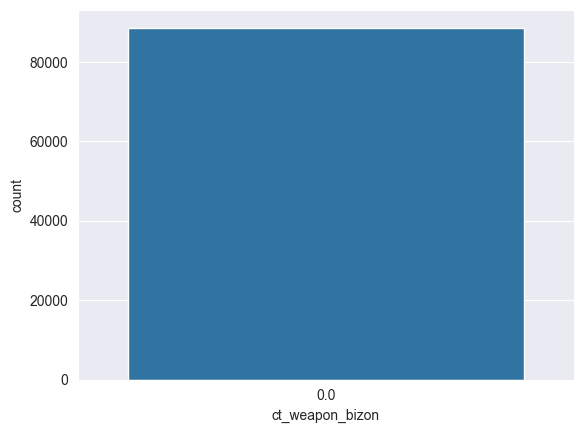

In [54]:
sns.countplot(x='ct_weapon_bizon', data=df)

Possiamo osservare che le colonne relative a equipaggiamenti non utilizzati (es. `ct_weapon_bizon`) contengono un solo valore univoco. Questo significa che nessun giocatore ha utilizzato quell'equipaggiamento durante i round catturati, di conseguenza queste colonne non forniscono alcuna **informazione** utile per il modello di machine learning.

Possiamo quindi procedere all'eliminazione di queste colonne dal dataset, in modo da ridurre la dimensionalità e migliorare le prestazioni del modello.

In [55]:
df.drop(columns=constant_columns, inplace=True)
df.head()

,time_left,ct_score,t_score,map,bomb_planted,ct_health,t_health,ct_armor,t_armor,ct_money,...,t_grenade_flashbang,ct_grenade_smokegrenade,t_grenade_smokegrenade,ct_grenade_incendiarygrenade,t_grenade_incendiarygrenade,ct_grenade_molotovgrenade,t_grenade_molotovgrenade,ct_grenade_decoygrenade,t_grenade_decoygrenade,round_winner
2,96.03,0.0,0.0,de_dust2,False,391.0,400.0,294.0,200.0,750.0,...,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
3,76.03,0.0,0.0,de_dust2,False,391.0,400.0,294.0,200.0,750.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
5,114.97,1.0,0.0,de_dust2,False,500.0,500.0,500.0,0.0,1750.0,...,0.0,3.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,CT
6,94.97,1.0,0.0,de_dust2,False,295.0,111.0,296.0,0.0,1700.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
7,74.97,1.0,0.0,de_dust2,False,295.0,111.0,296.0,0.0,1700.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CT


## Gestione dei dati insufficienti
Il dataset contiene dati relativi a diversi round giocati su varie mappe, rappresentate dalla colonna `map`. Verifichiamo che ogni mappa abbia un numero sufficiente di dati per garantire un'analisi e una modellazione affidabili.


In [56]:
# Controlliamo se ci sono abbastanza dati per ogni mappa
map_counts = df['map'].value_counts()

# Visualizza il conteggio
print("Numero di dati per ogni mappa:")
print(map_counts)


Numero di dati per ogni mappa:
map
de_inferno     17704
de_dust2       16003
de_nuke        13407
de_mirage      13334
de_overpass    10279
de_train        9609
de_vertigo      8241
de_cache         117
Name: count, dtype: int64


Dall'analisi dei conteggi per ogni mappa, è emerso che la mappa `"de_cache"` contiene un numero di dati significativamente inferiore rispetto alle altre. Con solo **145 istanze**, rispetto alle migliaia di dati presenti per le altre mappe, `"de_cache"` è considerata sottorappresentata.
Questo accade perché probabilmente la mappa `"de_cache"` è stata reinserita (o al contrario, rimossa) nel pool ufficiale di mappe (composto da 7 mappe) giocate nei tornei professionistici di CS:GO, alla fine del periodo di acquisizione dei dati (o all'inizio).

Un numero di dati così limitato non consente al modello di apprendere pattern significativi relativi a questa mappa, inoltre la presenza di una mappa con pochi dati potrebbe sbilanciare il processo di apprendimento, introducendo rumore e riducendo l'accuratezza complessiva del modello.

Procediamo, quindi, alla rimozione di tutte le istanze associate alla mappa `"de_cache"` per garantire che il dataset sia bilanciato e rappresentativo delle mappe principali.

In [57]:
df = df[df['map'] != 'de_cache']

# Conferma la rimozione
print("Distribuzione aggiornata delle mappe:")
print(df['map'].value_counts())

Distribuzione aggiornata delle mappe:
map
de_inferno     17704
de_dust2       16003
de_nuke        13407
de_mirage      13334
de_overpass    10279
de_train        9609
de_vertigo      8241
Name: count, dtype: int64


## Correzione degli errori noti sul dataset
Nel dataset sono stati segnalati errori noti, relativi al conteggio delle armi per alcune categorie. In particolare, le seguenti variabili contengono valori che superano il limite massimo di 5 armi per giocatore, il che non è possibile secondo le regole del gioco:

- `t_weapon_cz75auto`
- `t_weapon_glock`
- `ct_weapon_usps`

Questi valori anomali indicano errori nei dati e potrebbero compromettere la qualità dell'analisi e la precisione del modello.

Procediamo quindi all'eliminazione delle relative righe, per migliorare l'integrità e l'affidabilità del dataset.

In [58]:
# Stampa il numero di righe che verranno eliminate
print("Numero di righe anomale:",
      len(df[(df['t_weapon_cz75auto'] > 5) | (df['t_weapon_glock'] > 5) | (df['ct_weapon_usps'] > 5)]))

df.drop(df[(df['t_weapon_cz75auto'] > 5) | (df['t_weapon_glock'] > 5) | (df['ct_weapon_usps'] > 5)].index, inplace=True)
df.head()

Numero di righe anomale: 0


,time_left,ct_score,t_score,map,bomb_planted,ct_health,t_health,ct_armor,t_armor,ct_money,...,t_grenade_flashbang,ct_grenade_smokegrenade,t_grenade_smokegrenade,ct_grenade_incendiarygrenade,t_grenade_incendiarygrenade,ct_grenade_molotovgrenade,t_grenade_molotovgrenade,ct_grenade_decoygrenade,t_grenade_decoygrenade,round_winner
2,96.03,0.0,0.0,de_dust2,False,391.0,400.0,294.0,200.0,750.0,...,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
3,76.03,0.0,0.0,de_dust2,False,391.0,400.0,294.0,200.0,750.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
5,114.97,1.0,0.0,de_dust2,False,500.0,500.0,500.0,0.0,1750.0,...,0.0,3.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,CT
6,94.97,1.0,0.0,de_dust2,False,295.0,111.0,296.0,0.0,1700.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
7,74.97,1.0,0.0,de_dust2,False,295.0,111.0,296.0,0.0,1700.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CT


## Codifica delle Variabili categoriche
Nel nostro dataset, alcune variabili sono categoriche e devono essere trasformate in un formato numerico prima di poter essere utilizzate nei modelli di machine learning. Questo processo, noto come **encoding**, permette di rappresentare valori testuali (es. `"de_dust2"` o `"True"`) come numeri, preservando le relazioni e le informazioni originali.

In questo caso, utilizzeremo tecniche di encoding diverse in base alle caratteristiche di ciascuna variabile categorica:

- **One-Hot Encoding** per la variabile `map`, perché é una variabile categorica nominale. In altre parole, non esiste un ordine intrinseco tra le categorie, quindi vogliamo rappresentare ciascuna mappa come una colonna binaria.
- **Label Encoding** per le variabili `bomb_planted` e `round_winner`, perché hanno solo due stati possibili.

In [59]:
# Crea un LabelEncoder separato per ogni variabile categorica a eccezione di 'map' dove utilizzeremo OneHotEncoder
map_encoder = preprocessing.OneHotEncoder(sparse_output=False)
bomb_encoder = preprocessing.LabelEncoder()
winner_encoder = preprocessing.LabelEncoder()

# One-Hot Encoding
map_encoded = map_encoder.fit_transform(df[['map']])
# Converti in DataFrame con i nomi delle colonne basati sulle categorie
map_encoded_df = pd.DataFrame(map_encoded, columns=map_encoder.get_feature_names_out(['map']))

# Reimpostiamo gli indici dopo aver precedentemente rimosso le righe dal DataFrame
df.reset_index(drop=True, inplace=True)
# Aggiungi le colonne One-Hot al DataFrame originale
df = pd.concat([df, map_encoded_df], axis=1)
# Ora 'map' è stata sostituita da colonne One-Hot quindi possiamo rimuovere la colonna originale
df.drop('map', axis=1, inplace=True)

df['bomb_planted'] = bomb_encoder.fit_transform(df['bomb_planted'])
df['round_winner'] = winner_encoder.fit_transform(df['round_winner'])

df.head()

,time_left,ct_score,t_score,bomb_planted,ct_health,t_health,ct_armor,t_armor,ct_money,t_money,...,ct_grenade_decoygrenade,t_grenade_decoygrenade,round_winner,map_de_dust2,map_de_inferno,map_de_mirage,map_de_nuke,map_de_overpass,map_de_train,map_de_vertigo
0,96.03,0.0,0.0,0,391.0,400.0,294.0,200.0,750.0,500.0,...,0.0,0.0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
1,76.03,0.0,0.0,0,391.0,400.0,294.0,200.0,750.0,500.0,...,0.0,0.0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
2,114.97,1.0,0.0,0,500.0,500.0,500.0,0.0,1750.0,10550.0,...,0.0,0.0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
3,94.97,1.0,0.0,0,295.0,111.0,296.0,0.0,1700.0,5000.0,...,0.0,0.0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
4,74.97,1.0,0.0,0,295.0,111.0,296.0,0.0,1700.0,5000.0,...,0.0,0.0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0


In [60]:
df.info()
df.describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 88577 entries, 0 to 88576
Data columns (total 96 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   time_left                     88577 non-null  float64
 1   ct_score                      88577 non-null  float64
 2   t_score                       88577 non-null  float64
 3   bomb_planted                  88577 non-null  int64  
 4   ct_health                     88577 non-null  float64
 5   t_health                      88577 non-null  float64
 6   ct_armor                      88577 non-null  float64
 7   t_armor                       88577 non-null  float64
 8   ct_money                      88577 non-null  float64
 9   t_money                       88577 non-null  float64
 10  ct_helmets                    88577 non-null  float64
 11  t_helmets                     88577 non-null  float64
 12  ct_defuse_kits                88577 non-null  float64
 13  c

,time_left,ct_score,t_score,bomb_planted,ct_health,t_health,ct_armor,t_armor,ct_money,t_money,...,ct_grenade_decoygrenade,t_grenade_decoygrenade,round_winner,map_de_dust2,map_de_inferno,map_de_mirage,map_de_nuke,map_de_overpass,map_de_train,map_de_vertigo
count,88577.000000,88577.000000,88577.000000,88577.000000,88577.000000,88577.000000,88577.000000,88577.000000,88577.000000,88577.000000,...,88577.000000,88577.000000,88577.000000,88577.000000,88577.000000,88577.000000,88577.000000,88577.000000,88577.000000,88577.000000
mean,69.285562,6.702180,6.766971,0.154363,378.940233,365.899669,348.643937,342.766982,7254.541247,8677.800671,...,0.030267,0.027264,0.519164,0.180668,0.199871,0.150536,0.151360,0.116046,0.108482,0.093038
std,33.439078,4.833709,4.862175,0.361298,141.915446,148.558705,155.048734,152.899752,9018.894580,10074.433811,...,0.177410,0.168510,0.499635,0.384745,0.399906,0.357598,0.358401,0.320282,0.310990,0.290487
min,0.010000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,35.220000,3.000000,3.000000,0.000000,291.000000,264.000000,200.000000,251.000000,900.000000,1200.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,74.920000,6.000000,6.000000,0.000000,436.000000,403.000000,399.000000,391.000000,3850.000000,5050.000000,...,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,94.950000,10.000000,10.000000,0.000000,500.000000,500.000000,492.000000,482.000000,10600.000000,12100.000000,...,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,115.000000,32.000000,33.000000,1.000000,500.000000,500.000000,500.000000,500.000000,72450.000000,68300.000000,...,3.000000,2.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


## Aggregazione delle armi per categoria
Nel dataset, le armi sono rappresentate da variabili separate per ogni tipologia, ad esempio:
- `t_weapon_ak47`
- `ct_weapon_awp`
- `ct_weapon_m4a4`

Questa granularità offre un alto livello di dettaglio, ma presenta alcuni problemi:
1. **Elevata dimensionalità**: Un numero elevato di variabili aumenta la complessità del modello e potrebbe introdurre rumore.
2. **Bassa utilità di alcune feature**: Molte armi sono poco utilizzate, e mantenerle separatamente non apporta valore informativo significativo.
3. **Rischio di overfitting**: Un modello addestrato su dati troppo specifici potrebbe non generalizzare bene su nuovi dati.
4. **Minore interpretabilità**: Un modello con troppe feature può essere difficile da interpretare.


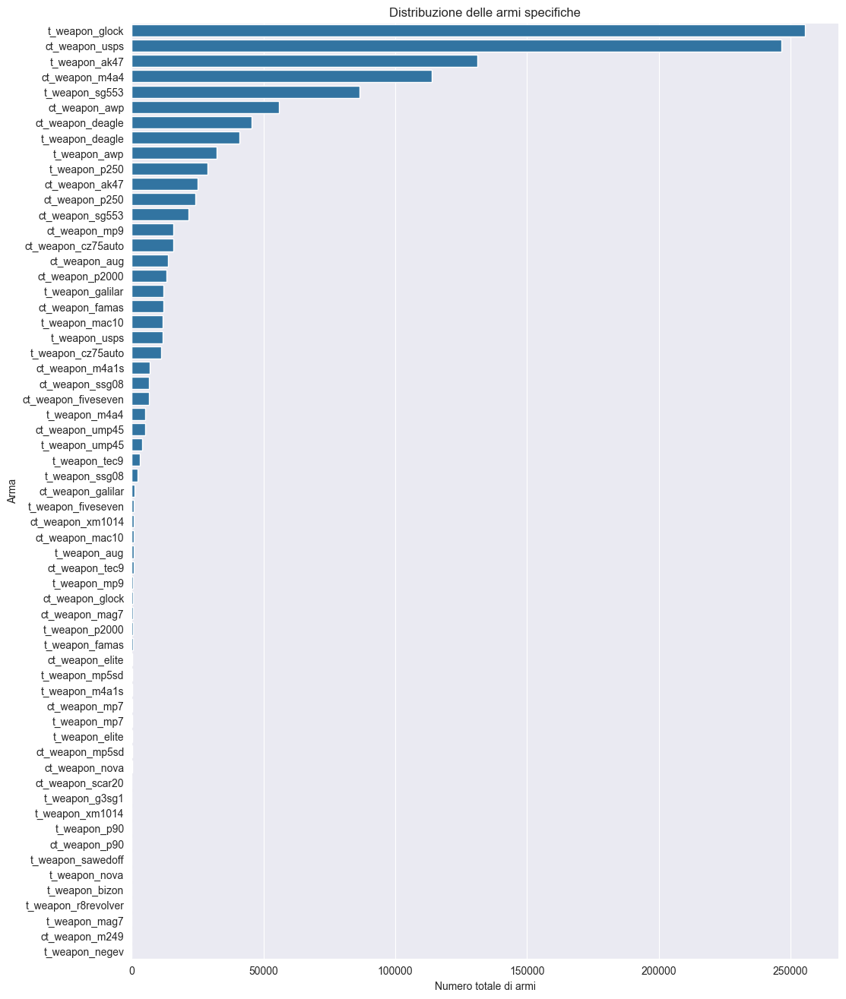

In [61]:
# Lista di colonne delle armi
weapon_columns = [col for col in df.columns if col.startswith('t_weapon') or col.startswith('ct_weapon')]

# Calcola la somma di ogni arma per ciascuna riga (giocatore)
weapon_sums = df[weapon_columns].sum()

# Ordina le armi in base alla frequenza di utilizzo
weapon_sums_sorted = weapon_sums.sort_values(ascending=False)

# Visualizza la distribuzione delle armi
plt.figure(figsize=(12, 16))
sns.barplot(x=weapon_sums_sorted.values, y=weapon_sums_sorted.index)
plt.title('Distribuzione delle armi specifiche')
plt.xlabel('Numero totale di armi')
plt.ylabel('Arma')
plt.show()

Come possiamo osservare, alcune armi appaiono come praticamente inutilizzate, ma questa è una caratteristica giustificata dal loro ruolo nel gioco. Ad esempio, `ct_weapon_glock` è l'arma di default per i Terroristi e non è acquistabile dai Contro-Terroristi, il che ne spiega il basso utilizzo tra le fila di quest'ultima squadra. Al contrario, armi come `t_weapon_negev`, pur essendo acquistabili da entrambe le squadre, sono raramente utilizzate. Questo comportamento può invece essere attribuito a fattori strategici, come la bassa efficacia in certe situazioni di gioco o il costo elevato rispetto ad altre armi più versatili.

Le armi verranno quindi raggruppato nelle seguenti categorie, per `ct` e `t`:
- **`rifle`**: Include fucili d'assalto come AK-47, M4A4, ecc.
- **`sniper`**: Include fucili di precisione come AWP, SSG 08, ecc.
- **`smg`**: Include mitragliette come MP9, UMP-45, ecc.
- **`default`**: Include armi di default ovvero USP-S, P2000 e Glock.
- **`pistol`**: Include pistole come Five-Seven, Deagle, ecc.
- **`heavy`**: Include armi pesanti come M249, Negev, ecc.
- **`shotgun`**: Include fucili a pompa come Nova, XM1014, ecc.

Verranno aggregate anche `grenade_incendiarygrenade` e `grenade_molotov` in **`grenade_incendiary`** in quanto rappresentano la stessa tipologia di granata. 

In [62]:
weapon_categories = {
    'ct_rifle': ['ct_weapon_ak47', 'ct_weapon_m4a4', 'ct_weapon_m4a1s', 'ct_weapon_aug', 'ct_weapon_famas',
                 'ct_weapon_galilar', 'ct_weapon_sg553'],
    't_rifle': ['t_weapon_ak47', 't_weapon_m4a4', 't_weapon_m4a1s', 't_weapon_aug', 't_weapon_famas',
                't_weapon_galilar', 't_weapon_sg553'],
    'ct_sniper': ['ct_weapon_awp', 'ct_weapon_scar20', 'ct_weapon_ssg08'],
    't_sniper': ['t_weapon_awp', 't_weapon_g3sg1', 't_weapon_ssg08'],
    'ct_smg': ['ct_weapon_mac10', 'ct_weapon_mp9', 'ct_weapon_mp7', 'ct_weapon_ump45', 'ct_weapon_p90',
               'ct_weapon_mp5sd'],
    't_smg': ['t_weapon_mac10', 't_weapon_mp9', 't_weapon_mp7', 't_weapon_ump45', 't_weapon_p90', 't_weapon_bizon',
              't_weapon_mp5sd'],
    'ct_default': ['ct_weapon_usps', 'ct_weapon_p2000', 'ct_weapon_glock'],
    't_default': ['t_weapon_usps', 't_weapon_p2000', 't_weapon_glock'],
    'ct_pistol': ['ct_weapon_p250', 'ct_weapon_fiveseven', 'ct_weapon_tec9', 'ct_weapon_cz75auto', 'ct_weapon_deagle',
                  'ct_weapon_elite'],
    't_pistol': ['t_weapon_p250', 't_weapon_fiveseven', 't_weapon_tec9', 't_weapon_cz75auto', 't_weapon_deagle',
                 't_weapon_r8revolver', 't_weapon_elite'],
    'ct_heavy': ['ct_weapon_m249'],
    't_heavy': ['t_weapon_negev'],
    'ct_shotgun': ['ct_weapon_nova', 'ct_weapon_xm1014', 'ct_weapon_mag7'],
    't_shotgun': ['t_weapon_nova', 't_weapon_xm1014', 't_weapon_mag7', 't_weapon_sawedoff']
}

incendiary_grenades_categories = {
    'ct_grenade_incendiary': ['ct_grenade_incendiarygrenade', 'ct_grenade_molotovgrenade'],
    't_grenade_incendiary': ['t_grenade_incendiarygrenade', 't_grenade_molotovgrenade']
}

# Creiamo nuove colonne aggregate per ciascuna categoria
for category, weapons in weapon_categories.items():
    df[f'{category}'] = df[weapons].sum(axis=1)

# Somma totale delle armi per ciascuna categoria
category_sums = df[[f'{category}' for category in weapon_categories]].sum()

# Ordinare le categorie in base alla somma totale
category_sums_sorted = category_sums.sort_values(ascending=False)

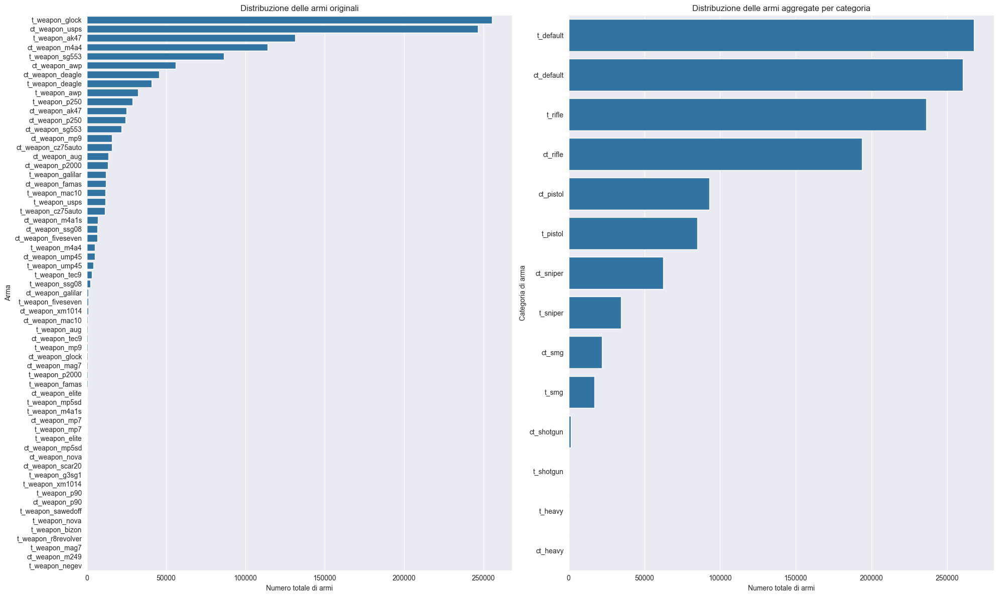

In [63]:
# Creiamo due subplots per confrontare le due distribuzioni
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 12))

# Grafico per la distribuzione delle armi originali
sns.barplot(x=weapon_sums_sorted.values, y=weapon_sums_sorted.index, ax=ax1)
ax1.set_title('Distribuzione delle armi originali')
ax1.set_xlabel('Numero totale di armi')
ax1.set_ylabel('Arma')

# Grafico per la distribuzione delle armi aggregate
sns.barplot(x=category_sums_sorted.values, y=category_sums_sorted.index, ax=ax2)
ax2.set_title('Distribuzione delle armi aggregate per categoria')
ax2.set_xlabel('Numero totale di armi')
ax2.set_ylabel('Categoria di arma')

plt.tight_layout()
plt.show()

Abbiamo ottenuto una rappresentazione più concisa e informativa delle armi, raggruppandole in categorie significative. Questo ci permette di mantenere informazioni rilevanti sulle preferenze dei giocatori per determinate tipologie di armi, riducendo al contempo la complessità del modello e migliorando la generalizzazione. 

Possiamo quindi procedere all'aggiornamento del dataset con le nuove colonne aggregate.

In [64]:
# Creazione delle nuove colonne aggregate per ciascuna categoria di armi
for category, weapons in weapon_categories.items():
    df[f'{category}'] = df[weapons].sum(axis=1)

for weapons in weapon_categories.values():
    df.drop(columns=weapons, inplace=True)

for category, grenades in incendiary_grenades_categories.items():
    df[f'{category}'] = df[grenades].sum(axis=1)

for grenades in incendiary_grenades_categories.values():
    df.drop(columns=grenades, inplace=True)

# Verifica delle modifiche
df.head()

,time_left,ct_score,t_score,bomb_planted,ct_health,t_health,ct_armor,t_armor,ct_money,t_money,...,ct_default,t_default,ct_pistol,t_pistol,ct_heavy,t_heavy,ct_shotgun,t_shotgun,ct_grenade_incendiary,t_grenade_incendiary
0,96.03,0.0,0.0,0,391.0,400.0,294.0,200.0,750.0,500.0,...,4.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,76.03,0.0,0.0,0,391.0,400.0,294.0,200.0,750.0,500.0,...,4.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,114.97,1.0,0.0,0,500.0,500.0,500.0,0.0,1750.0,10550.0,...,5.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3,94.97,1.0,0.0,0,295.0,111.0,296.0,0.0,1700.0,5000.0,...,3.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,74.97,1.0,0.0,0,295.0,111.0,296.0,0.0,1700.0,5000.0,...,3.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Controlliamo se ci sono valori anomali per le armi e le granate.

In [65]:
found_anomaly = False

# Itera su ogni categoria di armi nel dizionario
for category, weapons in weapon_categories.items():
    # Controlla se il numero di armi per la categoria è maggiore di 5
    invalid_rows = df[df[category] > 5]

    # Stampa il numero di righe con un valore maggiore di 5 per la categoria corrente
    if len(invalid_rows) > 0:
        found_anomaly = True
        print(f"Numero di righe con {category} > 5: {len(invalid_rows)}")

if not found_anomaly:
    print("Nessun valore anomalo per le armi")


Nessun valore anomalo per le armi


In [66]:
found_anomaly = False

# Facciamo lo stesso controllo per le granate
grenade_categories = [
    'ct_grenade_hegrenade', 'ct_grenade_flashbang', 'ct_grenade_smokegrenade', 'ct_grenade_incendiary',
    'ct_grenade_decoygrenade',
    't_grenade_hegrenade', 't_grenade_flashbang', 't_grenade_smokegrenade', 't_grenade_decoygrenade',
    't_grenade_incendiary'
]

# Itera su ogni categoria di granata
for grenade_col in grenade_categories:
    invalid_rows = df[df[grenade_col] > 5]

    if len(invalid_rows) > 0:
        found_anomaly = True
        print(f"Numero di righe con {grenade_col} > 5: {len(invalid_rows)}")

if not found_anomaly:
    print("Nessun valore anomalo per le granate")

Nessun valore anomalo per le granate


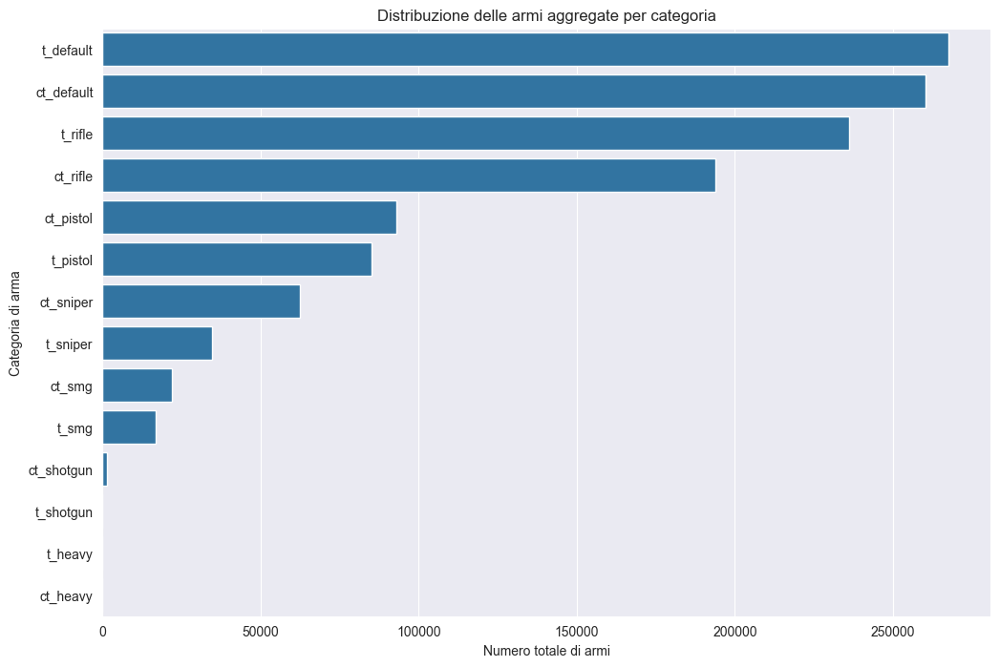

In [67]:
# Distribuzione delle colonne ct_rifle, t_rifle, ct_sniper, t_sniper, ct_smg, t_smg
weapon_category_columns = ['ct_rifle', 't_rifle', 'ct_sniper', 't_sniper', 'ct_smg', 't_smg', 'ct_default', 't_default', 'ct_pistol', 't_pistol', 'ct_heavy', 't_heavy', 'ct_shotgun', 't_shotgun']
weapon_category_sums = df[weapon_category_columns].sum()

# Ordina le categorie in base alla somma totale
weapon_category_sums_sorted = weapon_category_sums.sort_values(ascending=False)

# Visualizza la distribuzione delle armi aggregate
plt.figure(figsize=(12, 8))

sns.barplot(x=weapon_category_sums_sorted.values, y=weapon_category_sums_sorted.index)
plt.title('Distribuzione delle armi aggregate per categoria')
plt.xlabel('Numero totale di armi')
plt.ylabel('Categoria di arma')
plt.show()

Possiamo eliminare le colonne `ct_shotgun`, `t_shotgun`, `ct_heavy` e `t_heavy` in quanto sono poco utilizzate e non influenzano significativamente il gioco.

In [68]:
# Elimina le colonne relative agli shotgun e heavy weapons
df.drop(columns=['ct_shotgun', 't_shotgun', 'ct_heavy', 't_heavy'], inplace=True)
df.reset_index(drop=True, inplace=True)

Infine, possiamo anche eliminare le colonne relative alle granate decoy, in quanto non influenzano in alcun modo il gioco e non sono utilizzate per fini tattici.

In [69]:
# Elimina le colonne relative alle granate decoy
df.drop(columns=['ct_grenade_decoygrenade', 't_grenade_decoygrenade'], inplace=True)
df.reset_index(drop=True, inplace=True)

## Bilanciamento del dataset e analisi dei dati

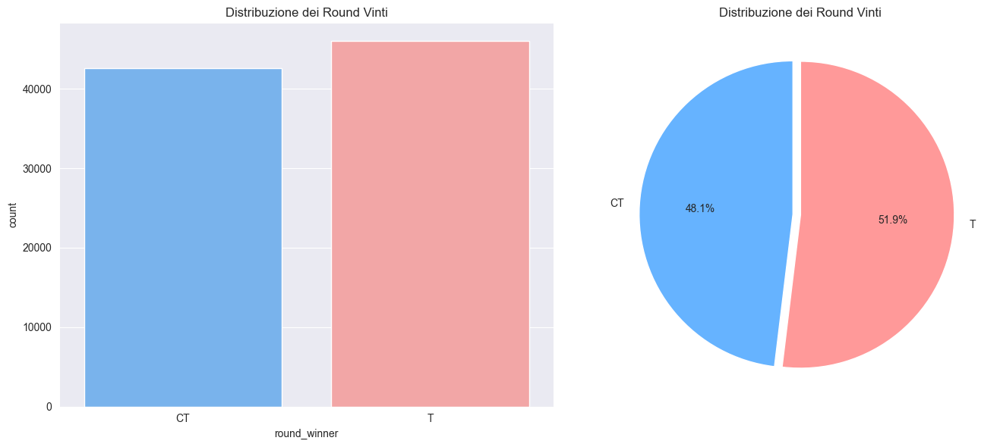

In [70]:
colors = [color_ct, color_t]
labels = ['CT', 'T']

# Creazione della figura con 2 sottotitoli (2 grafici affiancati)
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

# Grafico a barre (countplot)
sns.countplot(x='round_winner', data=df, palette=colors, hue='round_winner', legend=False, ax=axes[0])
axes[0].set_title('Distribuzione dei Round Vinti')
axes[0].set_xticks([0, 1])
axes[0].set_xticklabels(labels)

# Grafico a torta
round_winner_counts = df['round_winner'].value_counts(ascending=True)

axes[1].pie(round_winner_counts, labels=labels, autopct='%1.1f%%', startangle=90, colors=colors, explode=[0.05, 0])
axes[1].set_title('Distribuzione dei Round Vinti')

# Mostra i grafici
plt.tight_layout()
plt.show()

Dal grafico sopra possiamo osservare che il dataset è abbastanza **bilanciato** tra i round vinti dai Contro-Terroristi (0) e quelli vinti dai Terroristi (1). Questo è un aspetto positivo, poiché un bilanciamento corretto dei dati di addestramento è essenziale per evitare che il modello sviluppi bias verso una classe piuttosto che un'altra.

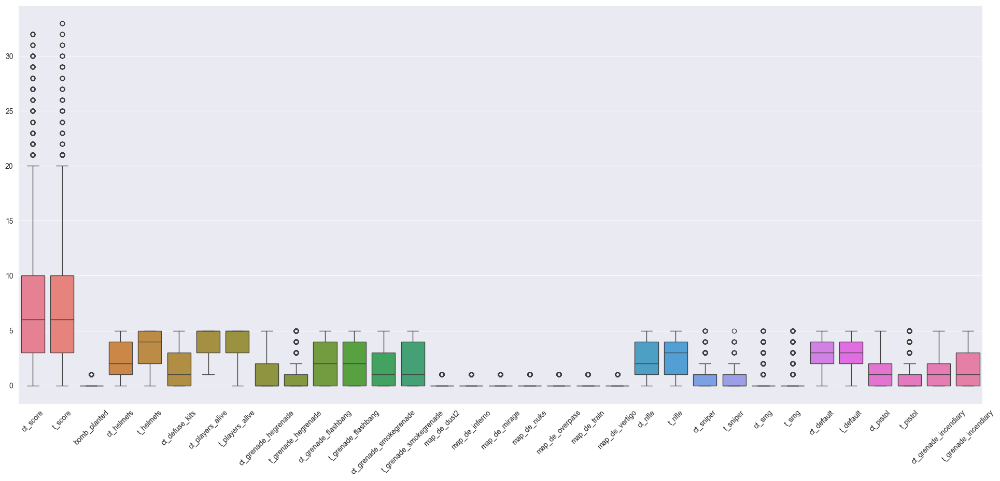

In [71]:
# Analisi degli outliers con boxplot
plt.figure(figsize=(24, 10))
sns.boxplot(data=df.drop(
    columns=['round_winner', 'ct_money', 't_money', 'ct_health', 't_health', 'ct_armor', 't_armor', 'time_left']))
plt.xticks(rotation=45)
plt.show()

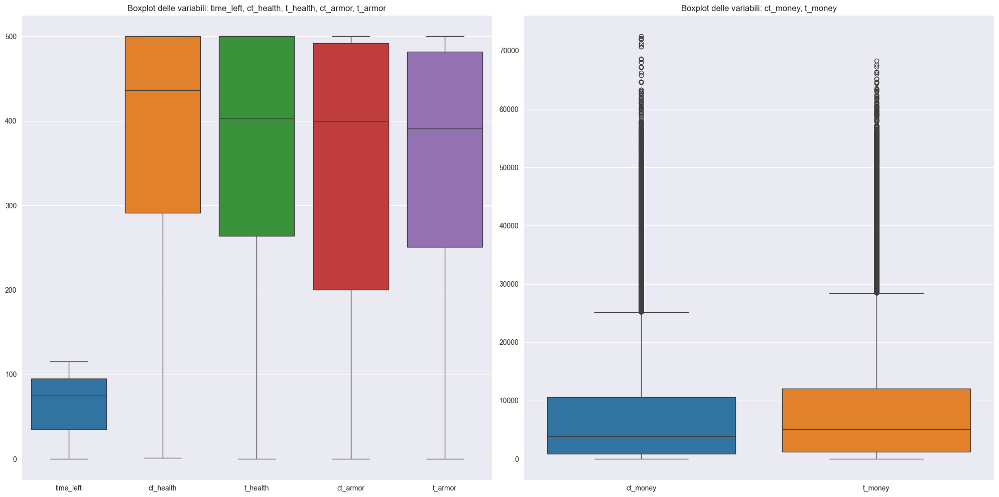

In [72]:
# Crea una figura con 2 sottotrame (uno accanto all'altro)
fig, axes = plt.subplots(1, 2, figsize=(20, 10))

# Primo grafico: Boxplot per 'time_left', 'ct_health', 't_health', 'ct_armor', 't_armor'
sns.boxplot(data=df[['time_left', 'ct_health', 't_health', 'ct_armor', 't_armor']], ax=axes[0])
axes[0].set_title('Boxplot delle variabili: time_left, ct_health, t_health, ct_armor, t_armor')

# Secondo grafico: Boxplot per 'ct_money' e 't_money'
sns.boxplot(data=df[['ct_money', 't_money']], ax=axes[1])
axes[1].set_title('Boxplot delle variabili: ct_money, t_money')

# Mostra i grafici
plt.tight_layout()  # Migliora la disposizione per evitare sovrapposizioni
plt.show()

Gli outliers problematici sono stati preventivamente eliminati e il dataset risulta abbastanza pulito e significativo.

Vediamo la distribuzione delle mappe giocate dai giocatori professionisti.

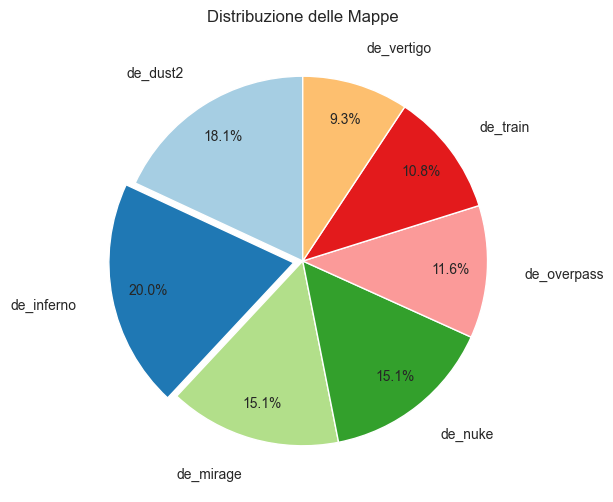

In [73]:
# Ottieni le colonne One-Hot delle mappe
map_columns = [col for col in df.columns if col.startswith('map_')]

# Calcolare le occorrenze di ciascuna mappa
map_counts = df[map_columns].sum()

# Rinominare le mappe rimuovendo il prefisso "map_"
map_counts.index = map_counts.index.str.replace('map_', '')

# Aggiungere l'effetto explode (separare la fetta più grande)
explode = [0.05 if i == map_counts.idxmax() else 0 for i in map_counts.index]

# Creare il grafico a torta
plt.figure(figsize=(12, 6))
map_counts.plot.pie(
    autopct='%1.1f%%',
    startangle=90,
    colors=plt.cm.Paired.colors,
    labeldistance=1.2,
    pctdistance=0.8,
    explode=explode
)
plt.title('Distribuzione delle Mappe')
plt.ylabel('')  # Toglie il label y
plt.show()

La mappa più giocata é de_inferno (20.0%), seguita da de_dust2 (18.1%) e de_nuke (15.1%) insieme a de_mirage (15.1%).
La mappa meno giocata é de_vertigo (9.3%).

Analizziamo la distribuzione dei round vinti in ogni mappa, per analizzare se vi é un vantaggio nel giocare da team Terrorista o Contro-Terrorista.

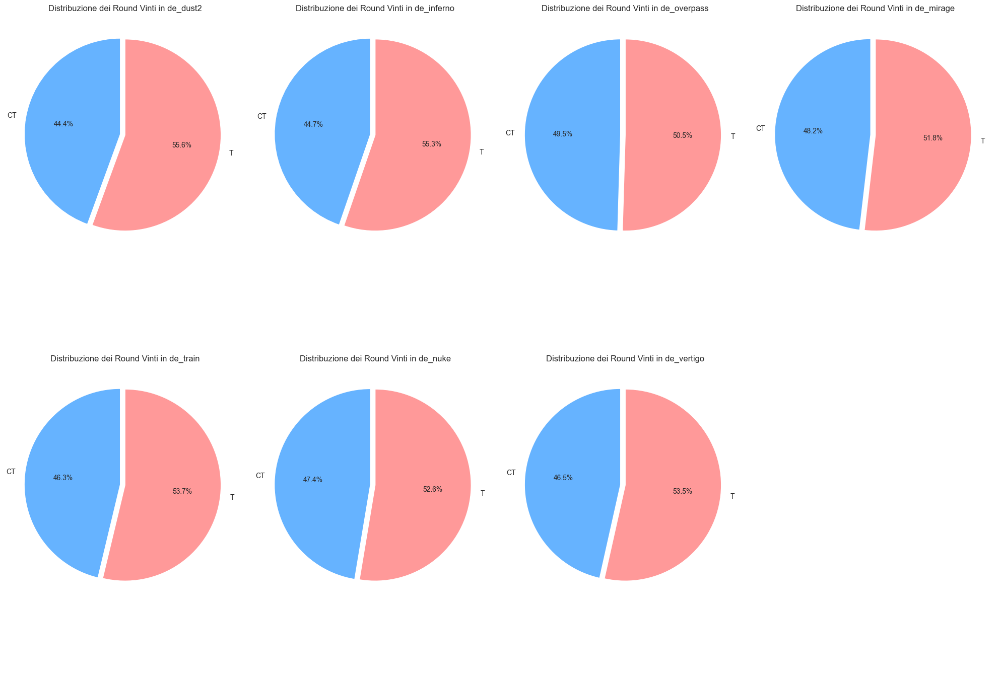

In [74]:
# Elenco delle mappe nel dataset (assumendo che il nome delle colonne sia come 'map_de_inferno')
map_columns = ['map_de_dust2', 'map_de_inferno', 'map_de_overpass', 'map_de_mirage', 'map_de_train', 'map_de_nuke',
               'map_de_vertigo']

# Configura il grafico
fig, axes = plt.subplots(2, 4, figsize=(20, 15))  # 2 righe e 4 colonne per i grafici
axes = axes.flatten()  # Appiattisce l'array degli assi

# Itera su tutte le mappe e crea il grafico per ciascuna
for idx, map_col in enumerate(map_columns):
    map_df = df[df[map_col] == 1]  # Filtra i dati per la mappa corrente
    round_winner_counts = map_df['round_winner'].value_counts(ascending=True)  # Conta i round vinti

    # Disegna il grafico a torta per ciascuna mappa
    axes[idx].pie(
        round_winner_counts,  # I conteggi dei round vinti
        autopct='%1.1f%%',  # Percentuali per ciascuna fetta
        startangle=90,  # Angolo di inizio
        colors=colors,  # Colori per CT e T
        labels=labels,  # Etichette per CT e T
        explode=[0.05, 0],  # Esplosione per la fetta T
    )
    axes[idx].set_title(f'Distribuzione dei Round Vinti in {map_col[4:]}')  # Titolo per ogni mappa
    axes[idx].set_ylabel('')  # Rimuove il label sull'asse Y

# Nascondi eventuali assi vuoti se ci sono meno heatmap di quelle previste
for j in range(len(map_columns), len(axes)):
    axes[j].axis('off')
# Aggiusta il layout per evitare sovrapposizioni
plt.tight_layout()
plt.show()

Pare che su tutte le mappe i T abbiano un vantaggio rispetto ai CT, in alcuni casi anche marcato, con l'eccezione di de_overpass dove i round vinti sono praticamente bilanciati.

Vediamo ora come l'economia influisce sui round vinti.

In [75]:
# 1. Calcola il numero di round vinti dalla squadra con il maggior numero di soldi
rounds_won_by_max_money_team = pd.concat([
    df[(df['ct_money'] > df['t_money']) & (df['round_winner'] == 0)],  # CT ha più soldi e vince
    df[(df['t_money'] > df['ct_money']) & (df['round_winner'] == 1)]  # T ha più soldi e vince
])

# 2. Calcola il numero di round persi dalla squadra con il maggior numero di soldi
rounds_lost_by_max_money_team = pd.concat([
    df[(df['ct_money'] > df['t_money']) & (df['round_winner'] == 1)],  # CT ha più soldi e perde
    df[(df['t_money'] > df['ct_money']) & (df['round_winner'] == 0)]  # T ha più soldi e perde
])

# 3. Calcola il numero di round con parità di denaro
rounds_with_equal_money = df[df['ct_money'] == df['t_money']]

# 4. Calcola la percentuale di round vinti
total_rounds = len(df)
rounds_won = len(rounds_won_by_max_money_team)
percent_rounds_won = (rounds_won / total_rounds) * 100

# 5. Calcola la percentuale di round persi
rounds_lost = len(rounds_lost_by_max_money_team)
percent_rounds_lost = (rounds_lost / total_rounds) * 100

# 6. Calcola la percentuale di round con parità di denaro
percent_equal_money_rounds = (len(rounds_with_equal_money) / total_rounds) * 100

# Mostra i risultati
print(f"Percentuale di round vinti dalla squadra con il maggior numero di soldi: {percent_rounds_won:.2f}%")
print(f"Percentuale di round persi dalla squadra con il maggior numero di soldi: {percent_rounds_lost:.2f}%")
print(f"Percentuale di round con parità di denaro tra le squadre: {percent_equal_money_rounds:.2f}%")


Percentuale di round vinti dalla squadra con il maggior numero di soldi: 59.26%
Percentuale di round persi dalla squadra con il maggior numero di soldi: 39.96%
Percentuale di round con parità di denaro tra le squadre: 0.78%


Quindi, la squadra con piú soldi vince tendenzialmente molti piú round rispetto a quella con meno soldi.

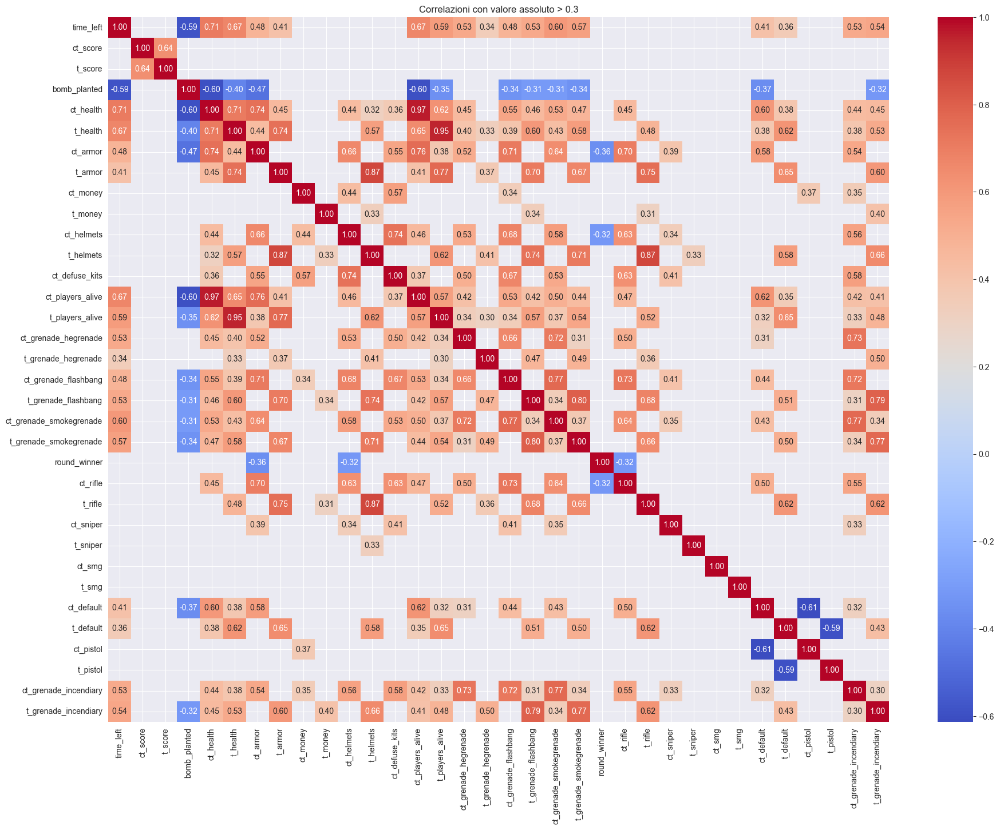

In [76]:
# Calcolare la matrice di correlazione
correlation_matrix = df.corr()

# Rimuovere le colonne che iniziano con "map_"
correlation_matrix = correlation_matrix.drop(
    columns=[col for col in correlation_matrix.columns if col.startswith('map_')],
    index=[col for col in correlation_matrix.columns if col.startswith('map_')])

# Filtrare le correlazioni con valore assoluto superiore a 0.5
high_corr = correlation_matrix[correlation_matrix.abs() > 0.3]

# Creiamo una heatmap per visualizzare solo le correlazioni forti
plt.figure(figsize=(22, 16))
sns.heatmap(high_corr, annot=True, fmt=".2f", cmap="coolwarm", cbar=True)
plt.title("Correlazioni con valore assoluto > 0.3")
plt.show()

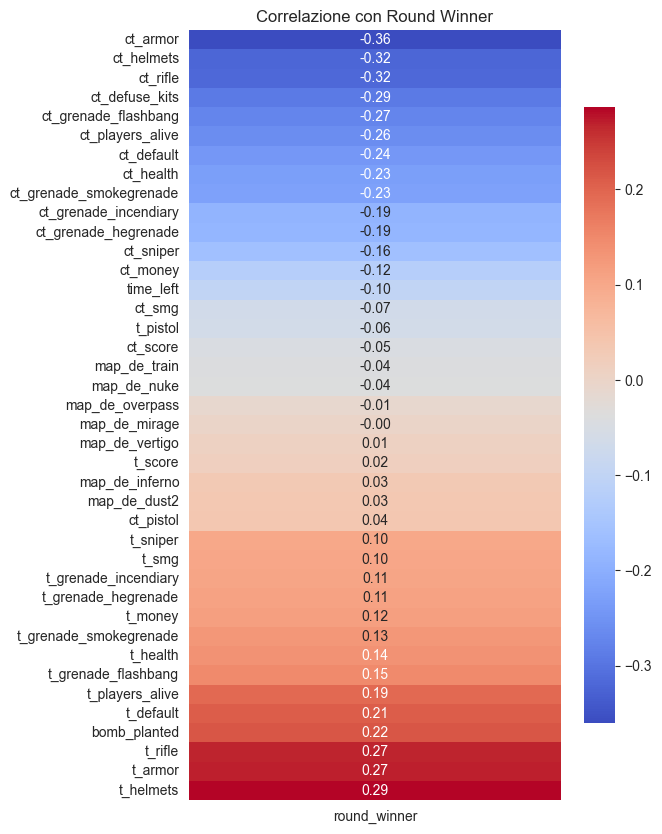

In [77]:
# Calcola le correlazioni tra 'round_winner' e tutte le altre colonne numeriche
correlation = df.corr()  # Calcola la matrice di correlazione
round_winner_corr = correlation['round_winner'].drop(
    'round_winner')  # Prendi solo la colonna 'round_winner' e rimuovi se stessa

# Ordina i valori in ordine crescente
round_winner_corr_sorted = round_winner_corr.sort_values()

plt.figure(figsize=(6, 10))
sns.heatmap(
    round_winner_corr_sorted.to_frame(),  # Converti in dataframe
    annot=True,
    fmt=".2f",
    cmap="coolwarm",
    cbar=True,
    cbar_kws={"shrink": 0.8},  # Riduce la dimensione della barra di colore per evitare sovrapposizioni
    xticklabels=True,
    yticklabels=True
)
plt.title("Correlazione con Round Winner")
plt.show()

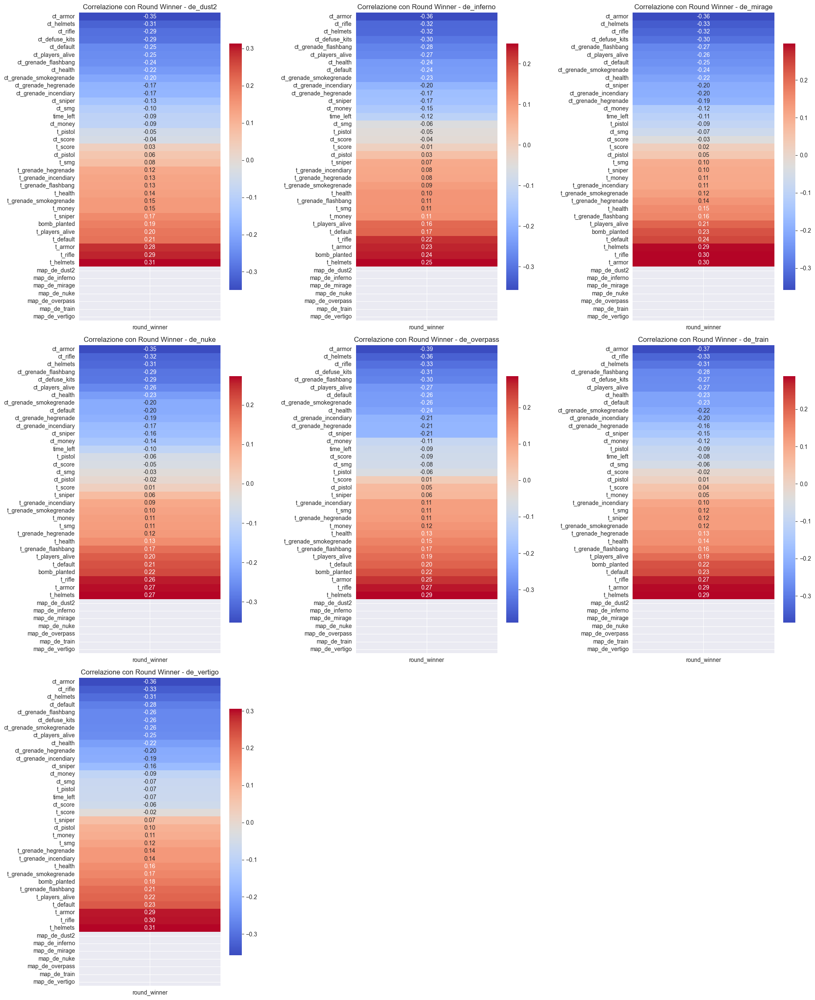

In [78]:
# Ottieni le colonne One-Hot delle mappe
map_columns = [col for col in df.columns if col.startswith('map_')]

# Calcolare il numero di colonne per la griglia
n_cols = 3
n_rows = (len(map_columns) // n_cols) + (1 if len(map_columns) % n_cols != 0 else 0)

# Crea la figura e i subplot
fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 8 * n_rows))
axes = axes.flatten()

# Itera su ogni colonna One-Hot e calcola le correlazioni
for i, map_col in enumerate(map_columns):
    # Filtra il dataset per la mappa corrente (dove la colonna della mappa è 1)
    df_map = df[df[map_col] == 1]

    # Calcola la matrice di correlazione per questa mappa
    correlation = df_map.corr()

    # Prendi solo la colonna 'round_winner'
    round_winner_corr = correlation['round_winner'].drop('round_winner').sort_values()

    # Plotta la heatmap
    sns.heatmap(
        round_winner_corr.to_frame(),
        annot=True,
        fmt=".2f",
        cmap="coolwarm",
        cbar=True,
        ax=axes[i],
        cbar_kws={"shrink": 0.8},  # Riduce la dimensione della barra di colore per evitare sovrapposizioni
        xticklabels=True,
        yticklabels=True
    )

    # Imposta il titolo per ciascun grafico
    axes[i].set_title(f"Correlazione con Round Winner - {map_col.replace('map_', '')}")

# Nascondi eventuali assi vuoti se ci sono meno heatmap di quelle previste
for j in range(len(map_columns), len(axes)):
    axes[j].axis('off')

plt.subplots_adjust(wspace=30, hspace=1)
plt.tight_layout()
plt.show()

In [79]:
fig = px.histogram(df, "ct_score")
fig.show()

fig = px.histogram(df, "t_score")
fig.show()

fig = px.histogram(df, "ct_health")
fig.show()

fig = px.histogram(df, "t_health")
fig.show()

fig = px.histogram(df, "ct_money")
fig.show()

fig = px.histogram(df, "t_money")
fig.show()

fig = px.histogram(df, "t_grenade_flashbang")
fig.show()

fig = px.histogram(df, "ct_grenade_smokegrenade")
fig.show()

fig = px.histogram(df, "ct_grenade_incendiary")
fig.show()

---

# Apprendimento Non Supervisionato

## Clustering KMeans

Il **clustering** è una tecnica di apprendimento non supervisionato che permette di raggruppare i dati in insiemi basati su caratteristiche simili, senza che siano disponibili etichette predefinite. Tra i metodi di clustering più utilizzati, il **KMeans** è uno dei più semplici ed efficaci.

Il KMeans è un algoritmo iterativo che suddivide un insieme di dati in un numero predefinito di gruppi (*k cluster*). L'obiettivo è minimizzare la varianza intra-cluster (la distanza tra i punti di ciascun cluster e il rispettivo centroide). 

Il processo si articola in tre passi principali:
1. **Inizializzazione**: Posizionamento casuale dei centri dei cluster (centroidi).
2. **Assegnazione**: Ogni punto viene assegnato al cluster con il centroide più vicino.
3. **Aggiornamento**: I centroidi vengono ricalcolati come media dei punti assegnati a ciascun cluster.

### Quando Utilizzare il KMeans?

Il KMeans è particolarmente efficace per:
- Dati con cluster ben separabili.
- Applicazioni in cui il numero di cluster è noto o stimabile.
- Analisi esplorativa dei dati.

Tuttavia, presenta alcune limitazioni:
- È sensibile alle scale.
- Richiede la scelta a priori del numero di cluster (*k*).

### Metriche per Valutare il Clustering

Per misurare l'efficacia del clustering ottenuto, si possono utilizzare le seguenti metriche:
- **Silhouette Score**: Valuta quanto i cluster sono separati tra loro e quanto i punti sono vicini ai centroidi dei rispettivi cluster. Varia tra -1 (clustering non efficace) e 1 (clustering ben definito).
- **Calinski-Harabasz Index**: Misura la densità e separazione dei cluster. Valori più alti indicano una migliore qualità del clustering.
- **Davies-Bouldin Index**: Stima la sovrapposizione tra i cluster. Valori più bassi indicano una migliore separazione.

---

Nell'ambito del progetto, ho applicato il KMeans sul dataframe per identificare pattern significativi nei round. 
L'obiettivo é raggruppare i round in base al tipo di situazione in cui si trovano le squadre, ad esempio in base a soldi, salute, equipaggiamento, tempo rimanente, ecc.

Ho confrontato diverse configurazioni e metriche per scegliere il miglior approccio di clustering.

In [80]:
data = df

scaler = preprocessing.StandardScaler()
data_scaled = scaler.fit_transform(data)

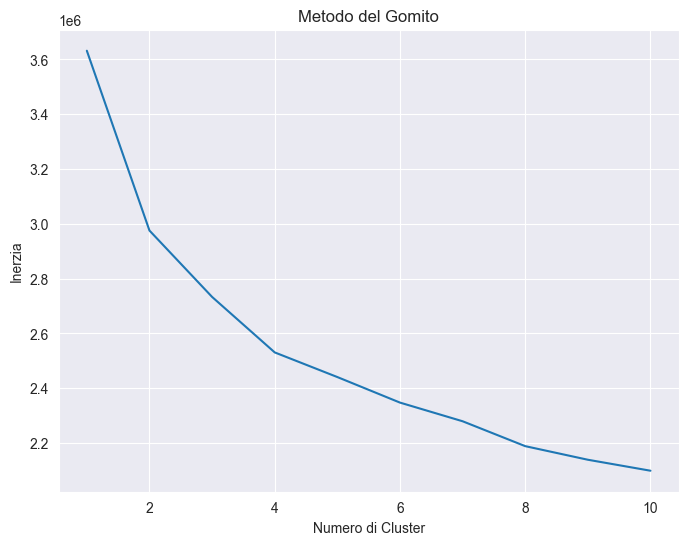

Il k ottimale è: 4


In [81]:
inertias = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', random_state=42)
    kmeans.fit(data_scaled)
    inertias.append(kmeans.inertia_)

# Grafico del metodo del gomito
plt.figure(figsize=(8, 6))
plt.plot(range(1, 11), inertias)
plt.title('Metodo del Gomito')
plt.xlabel('Numero di Cluster')
plt.ylabel('Inerzia')
plt.show()

kl = KneeLocator(range(1, 11), inertias, curve="convex", direction="decreasing")
print('Il k ottimale è: ' + str(kl.elbow))

In [82]:
# Applicare KMeans con il numero di cluster scelto = 4
kmeans = KMeans(n_clusters=kl.elbow, init='k-means++', random_state=42)
y_kmeans = kmeans.fit_predict(data_scaled)

In [83]:
df_kmeans = df.copy()
df_kmeans['cluster'] = y_kmeans

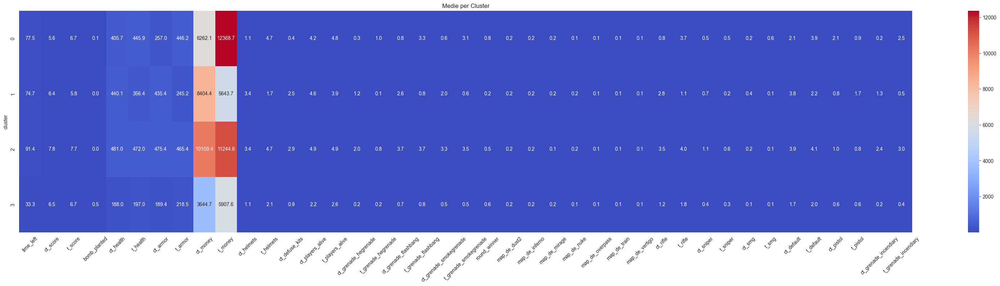

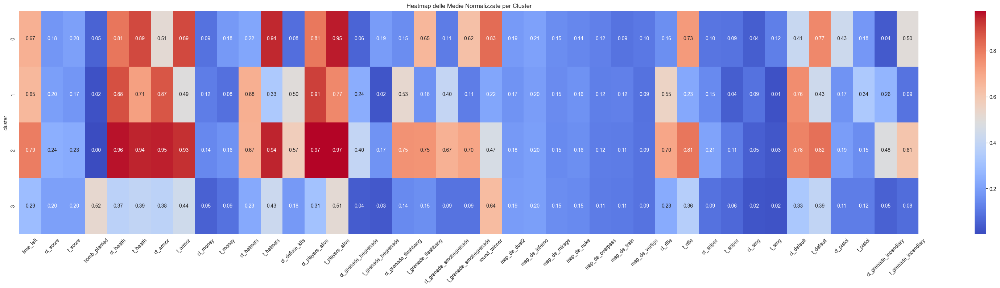

In [84]:
# Calcola la media per ciascun cluster
cluster_means = df_kmeans.groupby('cluster').mean()

# Heatmap delle medie
plt.figure(figsize=(40, 8))
sns.heatmap(cluster_means, cmap='coolwarm', annot=True, fmt=".1f")
plt.title("Medie per Cluster")
plt.xticks(rotation=45)
plt.show()

features = df_kmeans.drop(columns=['cluster'])

# Applica la normalizzazione MinMax solo alle colonne selezionate
scaler = preprocessing.MinMaxScaler()
normalized_data = scaler.fit_transform(features)

# Crea un DataFrame normalizzato
normalized_df = pd.DataFrame(normalized_data, columns=features.columns, index=df_kmeans.index)

normalized_df['cluster'] = df_kmeans['cluster']

# Calcola le medie per cluster
cluster_means_normalized = normalized_df.groupby('cluster').mean()

# Heatmap delle medie normalizzate
plt.figure(figsize=(40, 8))
sns.heatmap(cluster_means_normalized, cmap='coolwarm', annot=True, fmt=".2f")
plt.title("Heatmap delle Medie Normalizzate per Cluster")
plt.xticks(rotation=45)
plt.show()

Dai cluster creati possiamo individuare quattro situazioni distinte:
- **Cluster 0**: Questo cluster é caratterizzato da una situazione favorevole per CT, con equipaggiamento e salute migliore rispetto a T.
- **Cluster 1**: Questo cluster è caratterizzato da una situazione precaria sia per CT che per T, in termini di soldi, salute, e tutto ció che ne consegue. Inoltre, é composto prevalentemente da round inoltrati, con poco tempo rimanente.
- **Cluster 2**: Questo cluster é caratterizzato da una situazione favorevole per T, con equipaggiamento e salute migliore rispetto a CT.
- **Cluster 3**: Questo cluster é caratterizzato da una situazione equilibrata e mediamente buona per entrambe le squadre. É composto prevalentemente da snapshot verso l'inizio del round.

Vediamo ora come si distribuiscono i cluster.

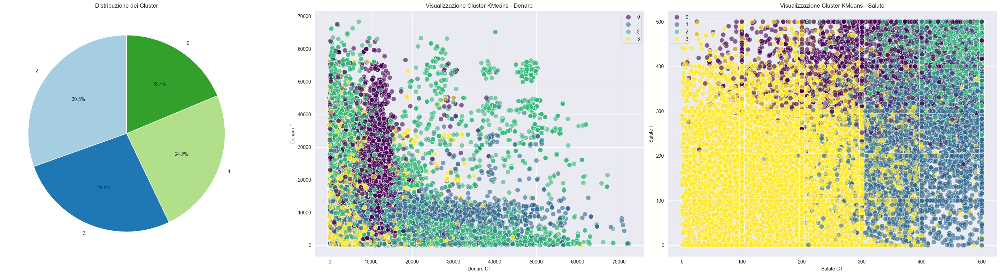

In [85]:
cluster_counts = df_kmeans['cluster'].value_counts()

fig, axes = plt.subplots(1, 3, figsize=(30, 8))
axes[0].pie(cluster_counts, labels=cluster_counts.index, autopct='%1.1f%%', startangle=90, colors=plt.cm.Paired.colors)
axes[0].set_title('Distribuzione dei Cluster')

sns.scatterplot(x=df_kmeans['ct_money'], y=df_kmeans['t_money'], hue=y_kmeans, palette='viridis', s=100, alpha=0.6,
                ax=axes[1])
axes[1].set_title('Visualizzazione Cluster KMeans - Denaro')
axes[1].set_xlabel('Denaro CT')
axes[1].set_ylabel('Denaro T')

sns.scatterplot(x=df_kmeans['ct_health'], y=df_kmeans['t_health'], hue=y_kmeans, palette='viridis', s=100, alpha=0.6,
                ax=axes[2])
axes[2].set_title('Visualizzazione Cluster KMeans - Salute')
axes[2].set_xlabel('Salute CT')
axes[2].set_ylabel('Salute T')

plt.tight_layout()
plt.show()

In [86]:
silhouette_avg = silhouette_score(data_scaled, y_kmeans)
print(f"Silhouette Score: {silhouette_avg}")

calinski_harabasz = calinski_harabasz_score(data_scaled, y_kmeans)
print(f"Calinski-Harabasz Score: {calinski_harabasz}")

# Calcola il Davies-Bouldin Index
davies_bouldin = davies_bouldin_score(data_scaled, y_kmeans)
print(f"Davies-Bouldin Score: {davies_bouldin}")

Silhouette Score: 0.13083893810749
Calinski-Harabasz Score: 12842.074231443325
Davies-Bouldin Score: 2.183224407527849


Nel clustering iniziale effettuato sull'intero dataframe (46 variabili), abbiamo osservato una distribuzione relativamente uniforme tra i cluster, con il Cluster 3 che rappresenta la maggior parte dei dati. Questo suggerisce che la maggior parte dei round tende a essere giocata in condizioni di equilibrio tra le squadre. Tuttavia, i grafici di dispersione rivelano una significativa sovrapposizione tra i cluster, confermata dal valore basso di Silhouette Score, che evidenzia la difficoltà nel separare chiaramente i dati in gruppi distinti.

Per migliorare la qualità del clustering, si é deciso di adottare due approcci alternativi:
- Applicazione del clustering KMeans su denaro delle squadre CT e T, escludendo le altre caratteristiche.
- Applicazione del clustering KMeans su numero di fucili delle squadre CT e T, escludendo le altre caratteristiche.

Questi approcci dovrebbero consentire di ottenere cluster piú distinti e significativi, andando a identificare situazioni di gioco specifiche in base al denaro o equipaggiamento disponibile per le squadre.

## Clustering KMeans - Denaro

In [87]:
# Seleziona solo le colonne di interesse: denaro CT e T
data = df[['ct_money', 't_money']]

scaler = preprocessing.StandardScaler()
data_scaled = scaler.fit_transform(data)

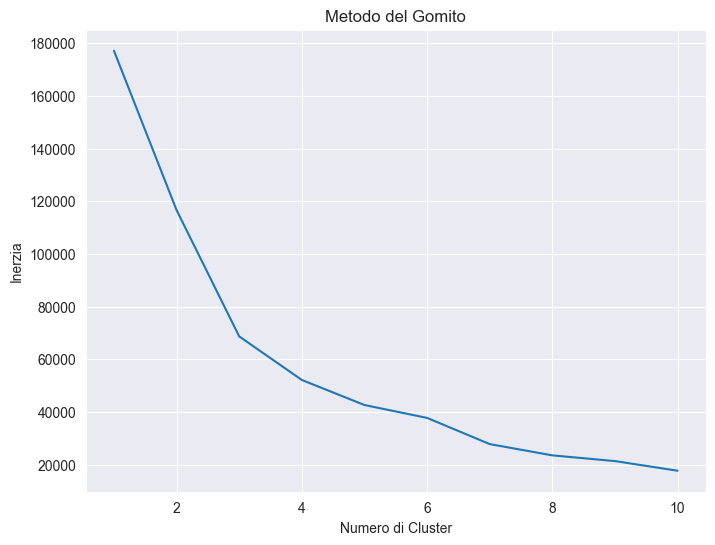

Il k ottimale è: 3


In [88]:
inertias = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', max_iter=300, random_state=42)
    kmeans.fit(data_scaled)
    inertias.append(kmeans.inertia_)

# Grafico del metodo del gomito
plt.figure(figsize=(8, 6))
plt.plot(range(1, 11), inertias)
plt.title('Metodo del Gomito')
plt.xlabel('Numero di Cluster')
plt.ylabel('Inerzia')
plt.show()

kl = KneeLocator(range(1, 11), inertias, curve="convex", direction="decreasing")
print('Il k ottimale è: ' + str(kl.elbow))

In [89]:
kmeans = KMeans(n_clusters=kl.elbow, init='k-means++', random_state=42)
y_kmeans_money = kmeans.fit_predict(data_scaled)

In [90]:
df_money_kmeans = df.copy()
df_money_kmeans['cluster'] = y_kmeans_money

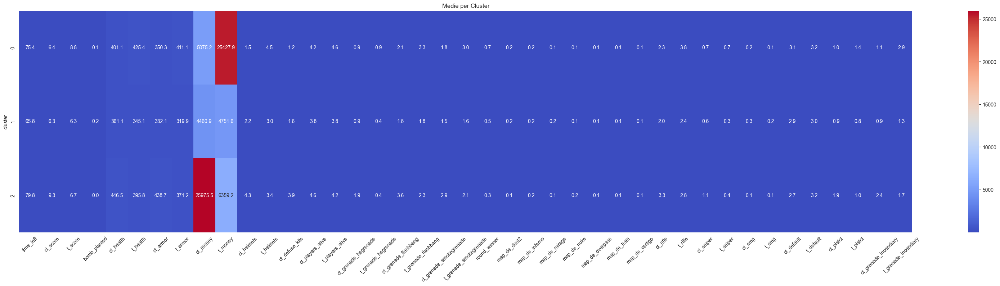

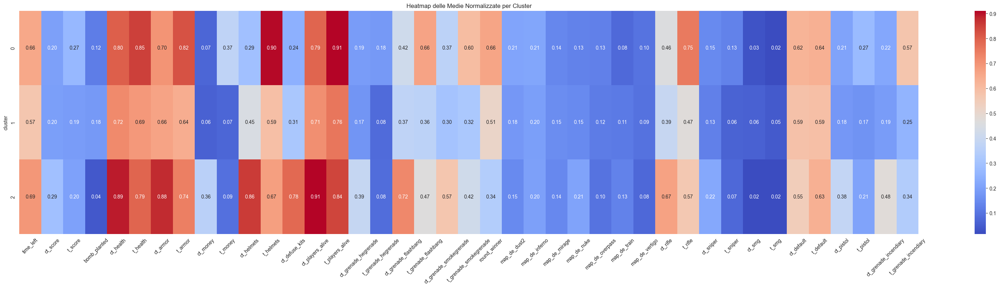

In [91]:
# Calcola la media per ciascun cluster
cluster_means = df_money_kmeans.groupby('cluster').mean()

# Heatmap delle medie
plt.figure(figsize=(40, 8))
sns.heatmap(cluster_means, cmap='coolwarm', annot=True, fmt=".1f")
plt.title("Medie per Cluster")
plt.xticks(rotation=45)
plt.show()

features = df_money_kmeans.drop(columns=['cluster'])

# Applica la normalizzazione MinMax solo alle colonne selezionate
scaler = preprocessing.MinMaxScaler()
normalized_data = scaler.fit_transform(features)

# Crea un DataFrame normalizzato
normalized_df = pd.DataFrame(normalized_data, columns=features.columns, index=df_money_kmeans.index)

normalized_df['cluster'] = df_money_kmeans['cluster']

# Calcola le medie per cluster
cluster_means_normalized = normalized_df.groupby('cluster').mean()

# Heatmap delle medie normalizzate
plt.figure(figsize=(40, 8))
sns.heatmap(cluster_means_normalized, cmap='coolwarm', annot=True, fmt=".2f")
plt.title("Heatmap delle Medie Normalizzate per Cluster")
plt.xticks(rotation=45)
plt.show()

In questo caso, dai cluster creati possiamo individuare tre situazioni distinte:
- **Cluster 0**: Questo cluster è caratterizzato da una situazione mediamente precaria ma equilibrata sia per CT che per T, in termini di soldi, quindi dovrebbero avere piú o meno le stesse risorse.
- **Cluster 1**: Questo cluster é caratterizzato da una situazione mediamente favorevole per T, con risorse migliori rispetto a CT.
- **Cluster 2**: Questo cluster é caratterizzato da una situazione mediamente favorevole per CT, con risorse migliori rispetto a T.

Vediamo se abbiamo ottenuto una divisione migliore dei dati rispetto al clustering precedente.

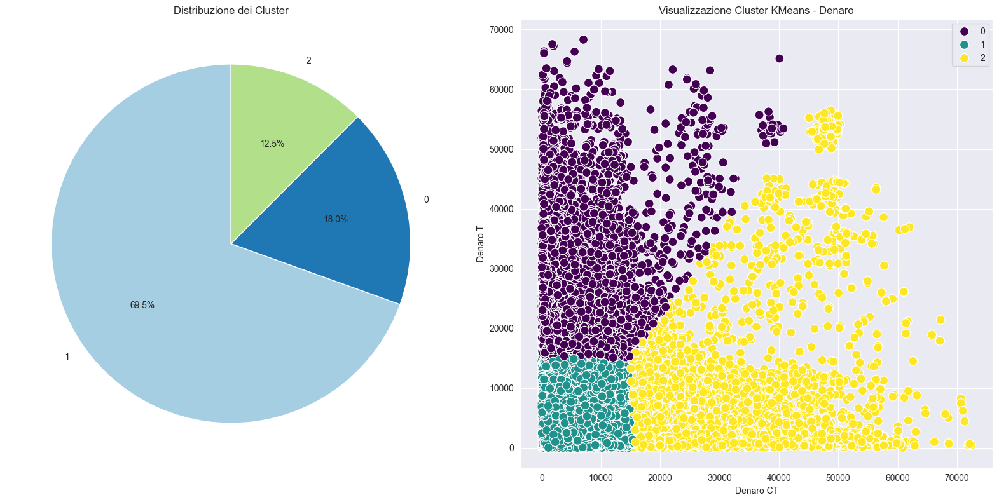

In [92]:
fig, axes = plt.subplots(1, 2, figsize=(16, 8))

cluster_counts = df_money_kmeans['cluster'].value_counts()
axes[0].pie(cluster_counts, labels=cluster_counts.index, autopct='%1.1f%%', startangle=90, colors=plt.cm.Paired.colors)
axes[0].set_title('Distribuzione dei Cluster')

sns.scatterplot(x=df_money_kmeans['ct_money'], y=df_money_kmeans['t_money'], hue=y_kmeans_money, palette='viridis',
                s=100, ax=axes[1])
axes[1].set_title('Visualizzazione Cluster KMeans - Denaro')
axes[1].set_xlabel('Denaro CT')
axes[1].set_ylabel('Denaro T')

plt.tight_layout()
plt.show()

In [93]:
silhouette_avg = silhouette_score(data_scaled, y_kmeans_money)
print(f"Silhouette Score: {silhouette_avg}")

calinski_harabasz = calinski_harabasz_score(data_scaled, y_kmeans_money)
print(f"Calinski-Harabasz Score: {calinski_harabasz}")

davies_bouldin = davies_bouldin_score(data_scaled, y_kmeans_money)
print(f"Davies-Bouldin Score: {davies_bouldin}")

Silhouette Score: 0.5182134735345436
Calinski-Harabasz Score: 69980.11868779676
Davies-Bouldin Score: 0.7351473949679933


Il clustering effettuato sulle variabili rilevanti ha portato a una divisione piú chiara e significativa dei dati, con cluster abbastanza ben distinti e facilmente interpretabili. 
Inoltre, i valori di Silhouette Score, Calinski-Harabasz Score e Davies-Bouldin Score confermano la bontà del clustering ottenuto.

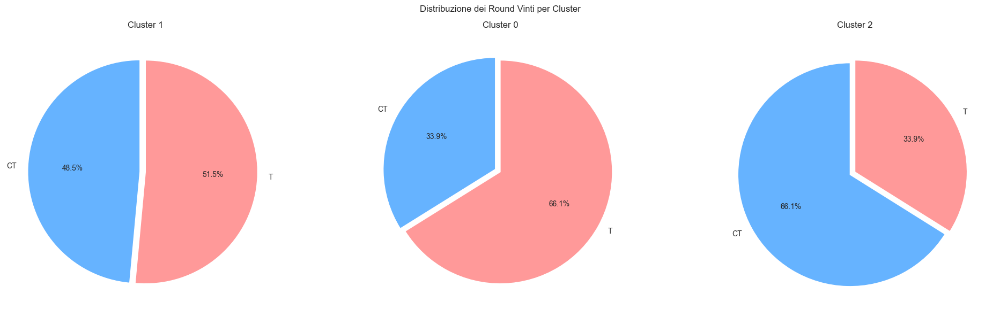

In [94]:
clusters = df_money_kmeans['cluster'].unique()

fig, axes = plt.subplots(1, len(clusters), figsize=(20, 6))
fig.suptitle("Distribuzione dei Round Vinti per Cluster")

for i, cluster in enumerate(clusters):
    # Filtra il dataset per il cluster corrente
    cluster_data = df_money_kmeans[df_money_kmeans['cluster'] == cluster]

    # Conta le occorrenze dei round vinti
    round_winner_counts = cluster_data['round_winner'].value_counts()

    sizes = [round_winner_counts.get(0), round_winner_counts.get(1)]

    axes[i].pie(
        sizes,
        labels=labels,
        autopct='%1.1f%%',
        startangle=90,
        colors=colors,
        explode=[0.05, 0]
    )
    axes[i].set_title(f'Cluster {cluster}')

plt.tight_layout()
plt.show()


Possiamo vedere che durante i round dove l'economia é equilibrata, i T hanno un leggerissimo vantaggio rispetto ai CT, mentre nei round in cui vi é una disparitá di denaro, la squadra con piú soldi vince la maggior parte dei round, come era stato giá visto precedentemente.

## Clustering KMeans - Fucili
Proviamo ora ad applicare il clustering KMeans sulle variabili 'ct_rifle' e 't_rifle', che rappresentano il numero di fucili posseduti dalle squadre CT e T rispettivamente e che potrebbe rappresentare meglio i round "*full buy*", "*eco*" e "*force buy*", al posto di utilizzare il denaro che potrebbe non essere un indicatore diretto della situazione di gioco, in quanto una squadra potrebbe avere speso tutto il denaro, ma essere comunque in possesso di 5 fucili. Infatti, il denaro indicato dalle colonne 'ct_money' e 't_money' non indicano il valore dell'equipaggiamento, ma solo il denaro disponibile in quel momento.

In [95]:
# Seleziona solo le colonne di interesse: rifle CT e T
data = df[['ct_rifle', 't_rifle']]

scaler = preprocessing.StandardScaler()
data_scaled = scaler.fit_transform(data)

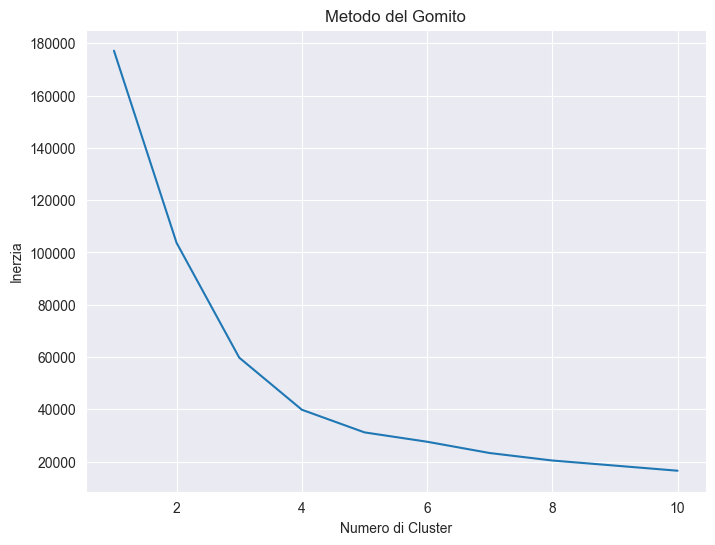

Il k ottimale è: 4


In [96]:
inertias = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', max_iter=300, random_state=42)
    kmeans.fit(data_scaled)
    inertias.append(kmeans.inertia_)

# Grafico del metodo del gomito
plt.figure(figsize=(8, 6))
plt.plot(range(1, 11), inertias)
plt.title('Metodo del Gomito')
plt.xlabel('Numero di Cluster')
plt.ylabel('Inerzia')
plt.show()

kl = KneeLocator(range(1, 11), inertias, curve="convex", direction="decreasing")
print('Il k ottimale è: ' + str(kl.elbow))

In [97]:
kmeans = KMeans(n_clusters=kl.elbow, init='k-means++', random_state=42)
y_kmeans_rifle = kmeans.fit_predict(data_scaled)

In [98]:
df_rifle_kmeans = df.copy()
df_rifle_kmeans['cluster'] = y_kmeans_rifle

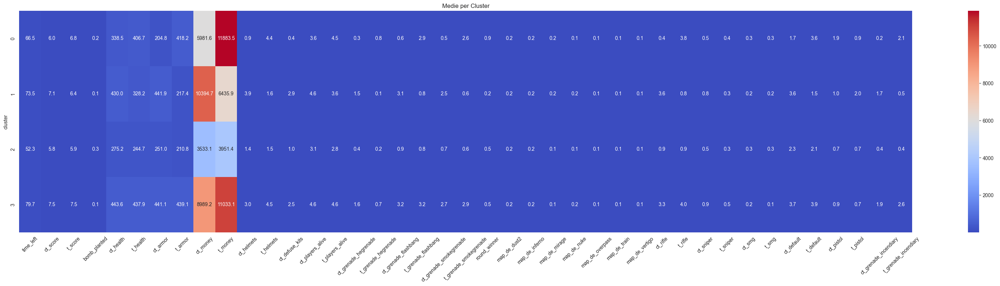

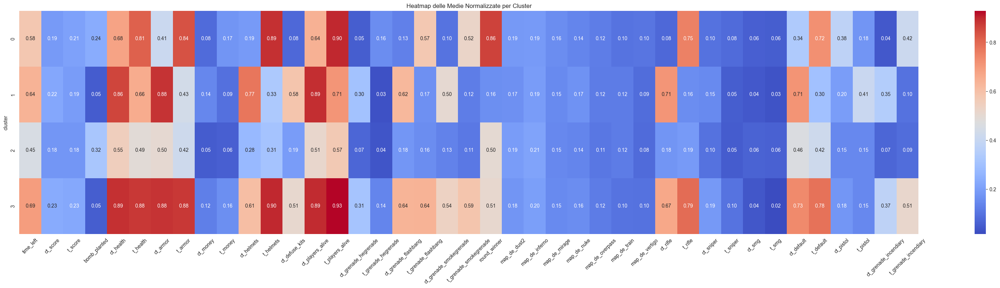

In [99]:
# Calcola la media per ciascun cluster
cluster_means = df_rifle_kmeans.groupby('cluster').mean()

# Heatmap delle medie
plt.figure(figsize=(40, 8))
sns.heatmap(cluster_means, cmap='coolwarm', annot=True, fmt=".1f")
plt.title("Medie per Cluster")
plt.xticks(rotation=45)
plt.show()

features = df_rifle_kmeans.drop(columns=['cluster'])

# Applica la normalizzazione MinMax solo alle colonne selezionate
scaler = preprocessing.MinMaxScaler()
normalized_data = scaler.fit_transform(features)

# Crea un DataFrame normalizzato
normalized_df = pd.DataFrame(normalized_data, columns=features.columns, index=df_rifle_kmeans.index)

normalized_df['cluster'] = df_rifle_kmeans['cluster']

# Calcola le medie per cluster
cluster_means_normalized = normalized_df.groupby('cluster').mean()

# Heatmap delle medie normalizzate
plt.figure(figsize=(40, 8))
sns.heatmap(cluster_means_normalized, cmap='coolwarm', annot=True, fmt=".2f")
plt.title("Heatmap delle Medie Normalizzate per Cluster")
plt.xticks(rotation=45)
plt.show()

In questo caso, dai cluster creati possiamo individuare quattro situazioni distinte:
- **Cluster 0**: Questo cluster é caratterizzato da una situazione favorevole per T, con piú fucili rispetto a CT. Rappresenta probabilmente una situazione di "*full buy*" per i Terroristi contro una situazione di "*eco*" o "*force*" per i Contro-Terroristi.
- **Cluster 1**: Questo cluster é caratterizzato da una situazione equilibrata e mediamente buona per entrambe le squadre. Rappresenta probabilmente una situazione di "*full buy*" per entrambe le squadre.
- **Cluster 2**: Questo cluster é caratterizzato da una situazione equilibrata ma mediamente cattiva per entrambe le squadre. Rappresenta probabilmente una situazione di "*eco*" o "*force buy*" per entrambe le squadre. Tipicamente sono i bonus round.
- **Cluster 3**: Questo cluster é caratterizzato da una situazione favorevole per CT, con piú fucili rispetto a T. Rappresenta probabilmente una situazione di "*full buy*" per i Contro-Terroristi contro una situazione di "*eco*" o "*force*" per i Terroristi.

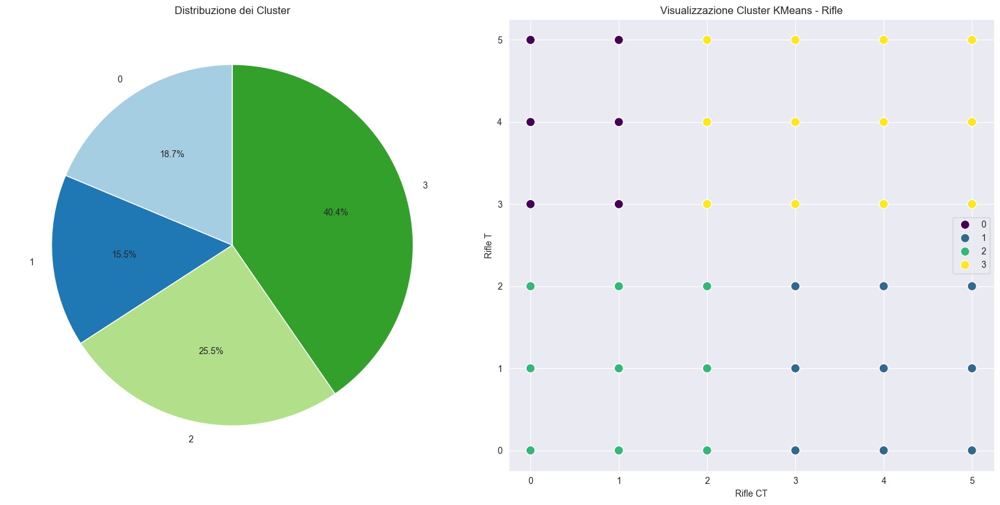

In [100]:
fig, axes = plt.subplots(1, 2, figsize=(16, 8))

cluster_counts = df_rifle_kmeans['cluster'].value_counts()
cluster_counts = cluster_counts.sort_index()

axes[0].pie(cluster_counts, labels=cluster_counts.index, autopct='%1.1f%%', startangle=90, colors=plt.cm.Paired.colors)
axes[0].set_title('Distribuzione dei Cluster')

sns.scatterplot(x=df_rifle_kmeans['ct_rifle'], y=df_rifle_kmeans['t_rifle'], hue=y_kmeans_rifle, palette='viridis',
                s=100, ax=axes[1])
axes[1].set_title('Visualizzazione Cluster KMeans - Rifle')
axes[1].set_xlabel('Rifle CT')
axes[1].set_ylabel('Rifle T')

plt.tight_layout()
plt.show()

In [101]:
silhouette_avg = silhouette_score(data_scaled, y_kmeans_rifle)
print(f"Silhouette Score: {silhouette_avg}")

calinski_harabasz = calinski_harabasz_score(data_scaled, y_kmeans_rifle)
print(f"Calinski-Harabasz Score: {calinski_harabasz}")

davies_bouldin = davies_bouldin_score(data_scaled, y_kmeans_rifle)
print(f"Davies-Bouldin Score: {davies_bouldin}")

Silhouette Score: 0.47779823489981743
Calinski-Harabasz Score: 101834.21931111177
Davies-Bouldin Score: 0.724553804583502


Sembra che anche il clustering basato sul numero di fucili posseduti dalle squadre CT e T abbia portato a una divisione chiara e significativa dei dati, con cluster ben distinti e facilmente interpretabili. 
Il valore di Silhouette Score é leggermente minore rispetto al clustering basato sul denaro, ma comunque paragonabile. 
Il valore di Davies-Bouldin Score é praticamente identico, mentre il Calinski-Harabasz Score é molto piú alto, indicando tutto sommato una qualitá del clustering migliore rispetto a quello basato sul denaro.

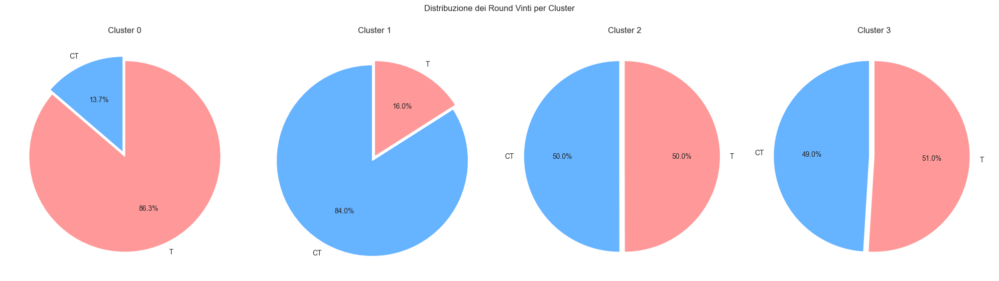

In [102]:
clusters = df_rifle_kmeans['cluster'].unique()
clusters.sort()

fig, axes = plt.subplots(1, len(clusters), figsize=(20, 6))
fig.suptitle("Distribuzione dei Round Vinti per Cluster")

for i, cluster in enumerate(clusters):
    # Filtra il dataset per il cluster corrente
    cluster_data = df_rifle_kmeans[df_rifle_kmeans['cluster'] == cluster]

    # Conta le occorrenze dei round vinti
    round_winner_counts = cluster_data['round_winner'].value_counts()

    sizes = [round_winner_counts.get(0), round_winner_counts.get(1)]

    axes[i].pie(
        sizes,
        labels=labels,
        autopct='%1.1f%%',
        startangle=90,
        colors=colors,
        explode=[0.05, 0]
    )
    axes[i].set_title(f'Cluster {cluster}')

plt.tight_layout()
plt.show()


In [103]:
df['cluster_money'] = y_kmeans_money
df['cluster_rifle'] = y_kmeans_rifle

In [104]:
# One-Hot encoding per i cluster
onehot_money = pd.get_dummies(df['cluster_money'], prefix='cluster_money').astype(int)
onehot_rifle = pd.get_dummies(df['cluster_rifle'], prefix='cluster_rifle').astype(int)

# Unisci le nuove colonne al DataFrame originale
df = pd.concat([df, onehot_money, onehot_rifle], axis=1)

# Rimuovi le colonne originali
df = df.drop(columns=['cluster_money', 'cluster_rifle'])

# Rimuovi le colonne che rappresentano i cluster
df = df.drop(columns=['t_rifle', 'ct_rifle', 't_money', 'ct_money'])

df.head()

,time_left,ct_score,t_score,bomb_planted,ct_health,t_health,ct_armor,t_armor,ct_helmets,t_helmets,...,t_pistol,ct_grenade_incendiary,t_grenade_incendiary,cluster_money_0,cluster_money_1,cluster_money_2,cluster_rifle_0,cluster_rifle_1,cluster_rifle_2,cluster_rifle_3
0,96.03,0.0,0.0,0,391.0,400.0,294.0,200.0,0.0,0.0,...,0.0,0.0,0.0,0,1,0,0,0,1,0
1,76.03,0.0,0.0,0,391.0,400.0,294.0,200.0,0.0,0.0,...,0.0,0.0,0.0,0,1,0,0,0,1,0
2,114.97,1.0,0.0,0,500.0,500.0,500.0,0.0,5.0,0.0,...,0.0,1.0,0.0,0,1,0,0,1,0,0
3,94.97,1.0,0.0,0,295.0,111.0,296.0,0.0,3.0,0.0,...,0.0,0.0,0.0,0,1,0,0,0,1,0
4,74.97,1.0,0.0,0,295.0,111.0,296.0,0.0,3.0,0.0,...,0.0,0.0,0.0,0,1,0,0,0,1,0


# Apprendimento Supervisionato

In questa sezione del caso di studio, ci concentreremo sull'apprendimento supervisionato per prevedere il risultato di un round in base alle caratteristiche delle squadre. Utilizzeremo i seguenti modelli di classificazione:
- **K-Nearest Neighbors (KNN):** Per la sua semplicità e adattabilitá.
- **Random Forest:** Per le sue performance anche su dataset con molte features e/o rumorosi.
- **XGBoost:** Per le sue prestazioni eccezionali su dataset complessi, grazie al boosting iterativo.


In [105]:
# Dividi il dataset in features e target
X = df.drop(columns=['round_winner'])
y = df['round_winner']

# Dividi il dataset in training e test set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Normalizza i dati
scaler = preprocessing.StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [106]:
models = {
    'K-Neighbors': KNeighborsClassifier(),
    'Random Forest': RandomForestClassifier(),
    'XGBoost': xg.XGBClassifier()
}

# Definisci gli iperparametri per ogni modello
params = {
    'K-Neighbors': {
        'n_neighbors': [1, 3, 5, 7],
        'metric': ['euclidean', 'manhattan'],
        'n_jobs': [-1]
    },
    'Random Forest': {
        'n_estimators': [100, 200, 300],
        'max_depth': [20, 25],
        'min_samples_split': [5, 10, 15, 20],
        'min_samples_leaf': [2, 4, 6, 8],
        'random_state': [13],
        'n_jobs': [-1]
    },
    'XGBoost': {
        'n_estimators': [50, 100, 150, 200, 300],
        'max_depth': [3, 5, 7, 10],
        'learning_rate': [0.01, 0.1, 0.5],
        'n_jobs': [-1]
    }
}

In [194]:
# Definizione funzioni
def hyperparameter_search(models, param_grids, X_train, y_train, method="bayes", scoring='accuracy', cv=5, n_iter=20):
    """
    Esegue la ricerca degli iperparametri per una lista di modelli utilizzando BayesSearchCV o GridSearchCV.

    Parametri:
    - models (dict): Dizionario con nome del modello come chiave e modello come valore.
    - param_grids (dict): Dizionario con il nome del modello come chiave e i parametri di ricerca come valore.
    - X_train (array): Dati di training.
    - y_train (array): Target di training.
    - method (str): Metodo di ricerca ('bayes' o 'grid').
    - scoring (str): Metrica per valutare i modelli.
    - cv (int): Numero di fold per la cross-validation.
    - n_iter (int): Numero di iterazioni (solo per BayesSearchCV).

    Ritorna:
    - best_models (dict): Dizionario dei modelli con i migliori iperparametri.
    """
    best_models = {}

    for model_name, model in models.items():
        print(f"Ricerca degli iperparametri per {model_name} ({method})")

        # Configura la ricerca in base al metodo
        if method == "bayes":
            search = BayesSearchCV(
                model,
                param_grids[model_name],
                scoring=scoring,
                n_jobs=-1,
                cv=cv,
                n_iter=n_iter
            )
        elif method == "grid":
            search = GridSearchCV(
                model,
                param_grids[model_name],
                scoring=scoring,
                n_jobs=-1,
                cv=cv
            )
        else:
            raise ValueError("Metodo non valido. Usa 'bayes' o 'grid'.")

        # Esegui la ricerca
        search.fit(X_train, y_train)

        # Salva il modello migliore
        best_models[model_name] = search.best_estimator_

        # Stampa i risultati
        print(f"Iperparametri migliori per {model_name}: {search.best_params_}")
        print(f"Best {scoring}: {search.best_score_:.4f}")
        print()

    return best_models

def evaluate_models(models, X_train, y_train, X_test, y_test):
    """
    Addestra i modelli e calcola le metriche di valutazione su training e test set.
    Stampa inoltre le matrici di confusione come testo.

    Parametri:
    - models (dict): Dizionario con nome del modello come chiave e modello come valore.
    - X_train (array): Dati di training.
    - y_train (array): Target di training.
    - X_test (array): Dati di test.
    - y_test (array): Target di test.

    Ritorna:
    - score_test (DataFrame): Metriche sul test set.
    - score_train (DataFrame): Metriche sul training set.
    """
    # Crea DataFrame vuoti per memorizzare le metriche
    score_test = pd.DataFrame(columns=['Recall', 'Precision', 'F1 Score', 'Accuracy', 'Modello', 'Order'])
    score_train = pd.DataFrame(columns=['Recall', 'Precision', 'F1 Score', 'Accuracy', 'Modello', 'Order'])

    for order, (model_name, model) in enumerate(models.items()):
        print(f"\n{'='*40}")
        print(f"Addestramento e valutazione per il modello: {model_name}")
        print(f"{'='*40}\n")

        # Addestra il modello
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)
        y_pred_train = model.predict(X_train)

        # Calcola le metriche sul test set
        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)

        # Calcola le metriche sul training set
        accuracy_train = accuracy_score(y_train, y_pred_train)
        precision_train = precision_score(y_train, y_pred_train)
        recall_train = recall_score(y_train, y_pred_train)
        f1_train = f1_score(y_train, y_pred_train)

        # Calcola le matrici di confusione
        conf_matrix_test = confusion_matrix(y_test, y_pred)
        conf_matrix_train = confusion_matrix(y_train, y_pred_train)

        # Stampa le matrici di confusione come testo
        print(f"Matrice di Confusione - {model_name} (Test):")
        print(conf_matrix_test)
        print(f"\nMatrice di Confusione - {model_name} (Train):")
        print(conf_matrix_train)

        # Aggiungi le metriche al DataFrame dei test set
        test_metrics = pd.DataFrame([(model_name + ' (Test)', recall, precision, f1, accuracy, order)],
                                    columns=['Modello', 'Recall', 'Precision', 'F1 Score', 'Accuracy', 'Order'])
        score_test = pd.concat([test_metrics, score_test], ignore_index=True)

        # Aggiungi le metriche al DataFrame dei training set
        train_metrics = pd.DataFrame([(model_name + ' (Train)', recall_train, precision_train, f1_train, accuracy_train, order)],
                                     columns=['Modello', 'Recall', 'Precision', 'F1 Score', 'Accuracy', 'Order'])
        score_train = pd.concat([train_metrics, score_train], ignore_index=True)

    # Ordina i DataFrame in base alla colonna "Order"
    score_test = score_test.sort_values(by='Order').drop(columns=['Order']).reset_index(drop=True)
    score_train = score_train.sort_values(by='Order').drop(columns=['Order']).reset_index(drop=True)

    # Stampa e ritorna i DataFrame
    print("\nMetriche sul Test Set:")
    print(score_test)

    print("\nMetriche sul Training Set:")
    print(score_train)

    return score_test, score_train


def compare_models(*model_scores, categories = None):
    """
    Combina e compara le metriche di più gruppi di modelli.

    Parametri:
    - model_scores: Lista di DataFrame con le metriche dei modelli.
    - categories (list): Lista di etichette per ogni gruppo di modelli.

    Ritorna:
    - combined_scores (DataFrame): DataFrame con tutte le metriche combinate e una colonna "Categoria".
    """
    combined_scores = pd.DataFrame()
    
    if categories is not None:
        for scores, category in zip(model_scores, categories):
            temp = scores.copy()
            temp['Categoria'] = category
            combined_scores = pd.concat([combined_scores, temp], ignore_index=True)
    else:
        for scores in model_scores:
            temp = scores.copy()
            combined_scores = pd.concat([combined_scores, temp], ignore_index=True)

    return combined_scores

def plot_histogram_comparison(combined_scores_train, combined_scores_test, metric):
    """
    Traccia un istogramma comparativo tra i risultati del training set e del test set per una specifica metrica.

    Parametri:
    - combined_scores_train (DataFrame): DataFrame combinato delle metriche sul training set.
    - combined_scores_test (DataFrame): DataFrame combinato delle metriche sul test set.
    - metric (str): Nome della metrica da comparare ('Accuracy', 'Recall', 'Precision', 'F1 Score').
    """
    # Rimuovi la parte "(Test)" o "(Train)" dai nomi dei modelli
    combined_scores_test['Modello'] = combined_scores_test['Modello'].str.replace(r'\s\(.*\)', '', regex=True)
    combined_scores_train['Modello'] = combined_scores_train['Modello'].str.replace(r'\s\(.*\)', '', regex=True)

    # Identifica i modelli e le categorie
    models = combined_scores_test['Modello'].unique()
    categories = combined_scores_test['Categoria'].unique()

    # Larghezza totale delle barre per ciascun gruppo di categorie
    bar_width = 0.2
    x = np.arange(len(models))  # Posizioni centrali per ciascun modello

    plt.figure(figsize=(12, 6))

    # Crea le barre per ogni categoria
    for idx, category in enumerate(categories):
        # Filtra i dati di training e test per questa categoria
        train_data = combined_scores_train[combined_scores_train['Categoria'] == category]
        test_data = combined_scores_test[combined_scores_test['Categoria'] == category]

        # Calcola la posizione delle barre per questa categoria
        bar_positions_train = x + idx * bar_width - (len(categories) * bar_width / 2)
        bar_positions_test = x + idx * bar_width - (len(categories) * bar_width / 2) + bar_width / 2

        # Barre del training set
        plt.bar(bar_positions_train, train_data[metric], bar_width / 2,
                label=f'{category} (Train)', alpha=0.7, color=f'C{idx * 2}')

        # Barre del test set
        plt.bar(bar_positions_test, test_data[metric], bar_width / 2,
                label=f'{category} (Test)', alpha=0.7, color=f'C{idx * 2 + 1}')

    # Configurazione del grafico
    plt.title(f'Confronto della {metric} tra Train e Test Set')
    plt.xlabel('Modelli')
    plt.ylabel(metric)
    plt.xticks(x, models, rotation=45, ha='right')
    plt.legend(loc='best')
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.ylim(0.65, None)  # L'asse y parte da 0.65 e il limite superiore è automatico
    plt.tight_layout()
    plt.show()

def plot_train_test_gap(combined_scores_train, combined_scores_test, metric):
    """
    Traccia un istogramma che mostra il gap tra le metriche del training set e del test set per ogni modello.
    Mostra anche la metrica del test set direttamente sopra ogni barra.

    Parametri:
    - combined_scores_train (DataFrame): DataFrame combinato delle metriche sul training set.
    - combined_scores_test (DataFrame): DataFrame combinato delle metriche sul test set.
    - metric (str): Nome della metrica da comparare ('Accuracy', 'Recall', 'Precision', 'F1 Score').
    """

    combined_scores_train['Modello'] = combined_scores_train['Modello'].str.replace(r'\s\(.*\)', '', regex=True)
    combined_scores_test['Modello'] = combined_scores_test['Modello'].str.replace(r'\s\(.*\)', '', regex=True)


    # Calcola il gap tra train e test
    train_metrics = combined_scores_train[['Modello', 'Categoria', metric]].rename(columns={metric: 'Train'})
    test_metrics = combined_scores_test[['Modello', 'Categoria', metric]].rename(columns={metric: 'Test'})

    # Merge dei dati
    merged_metrics = pd.merge(train_metrics, test_metrics, on=['Modello', 'Categoria'])
    merged_metrics['Gap'] = merged_metrics['Train'] - merged_metrics['Test']

    # Identifica modelli e categorie
    models = merged_metrics['Modello'].unique()
    categories = merged_metrics['Categoria'].unique()

    # Posizioni delle barre
    x = np.arange(len(models))  # Posizioni centrali per ogni modello
    bar_width = 0.2  # Larghezza di ogni barra

    plt.figure(figsize=(12, 6))

    # Crea le barre per ciascuna categoria
    for idx, category in enumerate(categories):
        category_data = merged_metrics[merged_metrics['Categoria'] == category]
        bar_positions = x + idx * bar_width - (len(categories) - 1) * bar_width / 2

        bars = plt.bar(
            bar_positions,  # Posizione delle barre
            category_data['Gap'],  # Valore del gap
            width=bar_width,  # Larghezza della barra
            label=category,  # Nome della categoria
            alpha=0.8
        )

        # Aggiungi annotazioni con il valore del test set
        for bar, test_value in zip(bars, category_data['Test']):
            plt.text(
                bar.get_x() + bar.get_width() / 2,  # Posizione centrale della barra
                bar.get_height() + 0.001,  # Altezza leggermente sopra la barra
                f'{test_value:.3f}',  
                ha='center', va='bottom', fontsize=9, color='black'
            )

    # Configurazione del grafico
    plt.xticks(x, models, rotation=45, ha='right')  # Etichette per i modelli
    plt.title(f'Gap Train-Test per {metric}')
    plt.xlabel('Modelli')
    plt.ylabel(f'Gap {metric} (Train - Test)')
    plt.axhline(0, color='black', linestyle='--', linewidth=0.8)  # Linea di riferimento per il gap 0
    plt.legend(title='Categoria')
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()

def plot_learning_curves(models, X_train, y_train, cv=5, scoring='accuracy'):
    """
    Traccia le curve di apprendimento (accuracy e loss) per una lista di modelli.

    Parametri:
    - models (dict): Dizionario con nome del modello come chiave e modello come valore.
    - X_train (array): Dati di training.
    - y_train (array): Target di training.
    - cv (int): Numero di fold per la cross-validation.
    - scoring (str): Metrica di valutazione per la curva.
    """
    num_models = len(models)
    cols = 3  # Numero di colonne per riga
    rows = math.ceil(num_models / cols)  # Numero di righe necessarie

    # Crea il layout del plot
    fig, axes = plt.subplots(rows, cols, figsize=(24, 6 * rows))
    axes = axes.flatten()  

    for idx, (model_name, model) in enumerate(models.items()):
        print(f"Calcolo delle curve di apprendimento per {model_name}")

        # Calcolo delle curve di apprendimento
        train_sizes, train_scores, test_scores = learning_curve(
            model, X_train, y_train, cv=cv, n_jobs=-1, scoring=scoring, return_times=False
        )

        # Calcolo delle metriche di loss
        train_loss = []
        test_loss = []

        for train_size in train_sizes:
            # Suddividi i dati di training in base alla dimensione
            X_train_subset = X_train[:train_size]
            y_train_subset = y_train[:train_size]

            # Addestra il modello
            model.fit(X_train_subset, y_train_subset)

            # Calcola il log-loss sul training set
            train_prob = model.predict_proba(X_train_subset)
            train_loss.append(log_loss(y_train_subset, train_prob))

            # Calcola il log-loss sul test set
            test_prob = model.predict_proba(X_train)
            test_loss.append(log_loss(y_train, test_prob))

        # Media, deviazione standard e varianza
        train_mean = train_scores.mean(axis=1)
        test_mean = test_scores.mean(axis=1)
        train_std = train_scores.std(axis=1)
        test_std = test_scores.std(axis=1)

        # Traccia le curve di accuracy
        ax = axes[idx]
        ax.plot(train_sizes, train_mean, label='Train Accuracy', color='blue')
        ax.plot(train_sizes, test_mean, label='Test Accuracy', color='red')

        # Traccia le curve di loss
        ax.plot(train_sizes, train_loss, label='Train Loss', color='blue', linestyle='dashed')
        ax.plot(train_sizes, test_loss, label='Test Loss', color='red', linestyle='dashed')

        # Bande di deviazione standard
        ax.fill_between(train_sizes, train_mean - train_std, train_mean + train_std, color='blue', alpha=0.2,
                        label='Train Std Dev')
        ax.fill_between(train_sizes, test_mean - test_std, test_mean + test_std, color='red', alpha=0.2,
                        label='Test Std Dev')

        # Configurazione del grafico
        ax.set_title(f'Curva di Apprendimento per {model_name}')
        ax.set_xlabel('Dimensione del Training Set')
        ax.set_ylabel('Score / Loss')
        ax.legend(loc='best')
        ax.grid(True)

    # Rimuove i plot vuoti, se il numero di modelli non è divisibile per 3
    for i in range(idx + 1, len(axes)):
        fig.delaxes(axes[i])

    plt.tight_layout()
    plt.show()

In [108]:
%%capture --no-stdout

# Grid Search per la ricerca degli iperparametri
best_models_first = hyperparameter_search(models, params, X_train, y_train, method="grid", scoring='accuracy')

Ricerca degli iperparametri per K-Neighbors (grid)
Iperparametri migliori per K-Neighbors: {'metric': 'manhattan', 'n_jobs': -1, 'n_neighbors': 1}
Best accuracy: 0.8190

Ricerca degli iperparametri per Random Forest (grid)
Iperparametri migliori per Random Forest: {'max_depth': 25, 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 300, 'n_jobs': -1, 'random_state': 13}
Best accuracy: 0.8072

Ricerca degli iperparametri per XGBoost (grid)
Iperparametri migliori per XGBoost: {'learning_rate': 0.5, 'max_depth': 10, 'n_estimators': 300, 'n_jobs': -1}
Best accuracy: 0.8213



Procediamo con la valutazione dei modelli.

In tutto il caso di studio, calcoleremo le metriche di Accuracy, Recall, Precision e F1 Score, sia per il Test Set, che per il Training Set, per avere una visione completa delle performance dei modelli e per identificare eventuali problemi di **overfitting**.

In [109]:
%%capture --no-stdout

# Valutazione dei modelli
score_test_first, score_train_first = evaluate_models(best_models_first, X_train, y_train, X_test, y_test)


Addestramento e valutazione per il modello: K-Neighbors

Matrice di Confusione - K-Neighbors (Test):
[[7053 1445]
 [1480 7738]]

Matrice di Confusione - K-Neighbors (Train):
[[34089     4]
 [    8 36760]]

Addestramento e valutazione per il modello: Random Forest

Matrice di Confusione - Random Forest (Test):
[[7097 1401]
 [1805 7413]]

Matrice di Confusione - Random Forest (Train):
[[33375   718]
 [  812 35956]]

Addestramento e valutazione per il modello: XGBoost

Matrice di Confusione - XGBoost (Test):
[[7118 1380]
 [1476 7742]]

Matrice di Confusione - XGBoost (Train):
[[34082    11]
 [   12 36756]]

Metriche sul Test Set:
                Modello    Recall  Precision  F1 Score  Accuracy
0    K-Neighbors (Test)  0.839445   0.842644  0.841041  0.834895
1  Random Forest (Test)  0.804187   0.841048  0.822205  0.819034
2        XGBoost (Test)  0.839878   0.848717  0.844275  0.838790

Metriche sul Training Set:
                 Modello    Recall  Precision  F1 Score  Accuracy
0    K-Nei

Calcolo delle curve di apprendimento per K-Neighbors
Calcolo delle curve di apprendimento per Random Forest
Calcolo delle curve di apprendimento per XGBoost


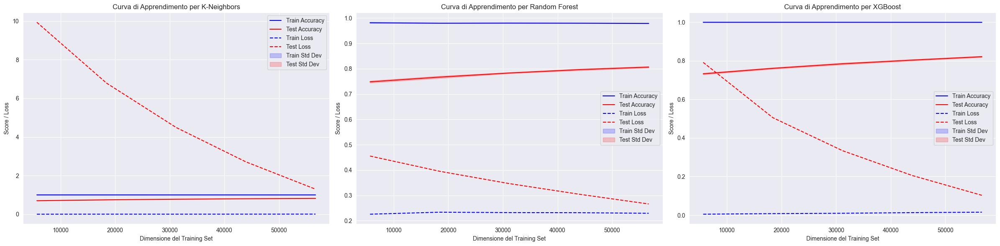

In [110]:
# Traccia le curve di apprendimento
plot_learning_curves(best_models_first, X_train, y_train)

É evidente la presenza di overfitting in tutti i modelli, con performance di molto migliori sul training set rispetto al test set. Questo potrebbe essere dovuto alla complessitá dei modelli utilizzati, che potrebbero non generalizzare bene i dati.

## Ottimizzazione dei modelli

Proviamo a ottimizzare i modelli per ridurre l'overfitting e rendere i modelli piú robusti e piú capaci di generalizzare.

In [127]:
params_bayes = {
    'K-Neighbors': {
        'n_neighbors': (20, 25),
        'metric': ['manhattan'],
        'n_jobs': [-1]
    },
    'Random Forest': {
        'n_estimators': (50, 200),  # Range per il numero di alberi
        'max_depth': (8, 9),  # Limita la profondità
        'min_samples_split': (10, 20),  # Maggiore valore riduce l'overfitting
        'min_samples_leaf': (2, 6),  # Limita la granularità delle foglie
        'max_features': ['sqrt'],  # Limita il numero di feature
        'bootstrap': [True],
        'random_state': [13],
        'n_jobs': [-1]
    },
    'XGBoost': {
        'max_depth': (5, 7),
        'learning_rate': (0.01, 0.025),
        'n_estimators': (100, 300),
        'colsample_bytree': (0.3, 1.0),
        'subsample': (0.5, 1.0),
        'gamma': (0, 10),
        'min_child_weight': (1, 10),
        'reg_lambda': (0, 10),
        'reg_alpha': (0, 10),
        'random_state': [13],
        'n_jobs': [-1]
    }
}

In [128]:
%%capture --no-stdout

best_models_optimised = hyperparameter_search(models, params_bayes, X_train, y_train, method="bayes", scoring='accuracy')

Ricerca degli iperparametri per K-Neighbors (bayes)
Iperparametri migliori per K-Neighbors: OrderedDict({'metric': 'manhattan', 'n_jobs': -1, 'n_neighbors': 21})
Best accuracy: 0.7590

Ricerca degli iperparametri per Random Forest (bayes)
Iperparametri migliori per Random Forest: OrderedDict({'bootstrap': True, 'max_depth': 9, 'max_features': 'sqrt', 'min_samples_leaf': 4, 'min_samples_split': 10, 'n_estimators': 199, 'n_jobs': -1, 'random_state': 13})
Best accuracy: 0.7487

Ricerca degli iperparametri per XGBoost (bayes)
Iperparametri migliori per XGBoost: OrderedDict({'colsample_bytree': 0.95399696756851, 'gamma': 0, 'learning_rate': 0.022727628715602646, 'max_depth': 7, 'min_child_weight': 1, 'n_estimators': 295, 'n_jobs': -1, 'random_state': 13, 'reg_alpha': 0, 'reg_lambda': 1, 'subsample': 0.8701732343145314})
Best accuracy: 0.7607



In [129]:
%%capture --no-stdout

# Valutazione dei modelli
score_test_optimised, score_train_optimised = evaluate_models(best_models_optimised, X_train, y_train, X_test, y_test)


Addestramento e valutazione per il modello: K-Neighbors

Matrice di Confusione - K-Neighbors (Test):
[[6579 1919]
 [2178 7040]]

Matrice di Confusione - K-Neighbors (Train):
[[27206  6887]
 [ 7856 28912]]

Addestramento e valutazione per il modello: Random Forest

Matrice di Confusione - Random Forest (Test):
[[6713 1785]
 [2629 6589]]

Matrice di Confusione - Random Forest (Train):
[[27381  6712]
 [10298 26470]]

Addestramento e valutazione per il modello: XGBoost

Matrice di Confusione - XGBoost (Test):
[[6747 1751]
 [2473 6745]]

Matrice di Confusione - XGBoost (Train):
[[27924  6169]
 [ 9236 27532]]

Metriche sul Test Set:
                Modello    Recall  Precision  F1 Score  Accuracy
0    K-Neighbors (Test)  0.763723   0.785802  0.774605  0.768740
1  Random Forest (Test)  0.714797   0.786840  0.749090  0.750847
2        XGBoost (Test)  0.731721   0.793903  0.761545  0.761571

Metriche sul Training Set:
                 Modello    Recall  Precision  F1 Score  Accuracy
0    K-Nei

Calcolo delle curve di apprendimento per K-Neighbors
Calcolo delle curve di apprendimento per Random Forest
Calcolo delle curve di apprendimento per XGBoost


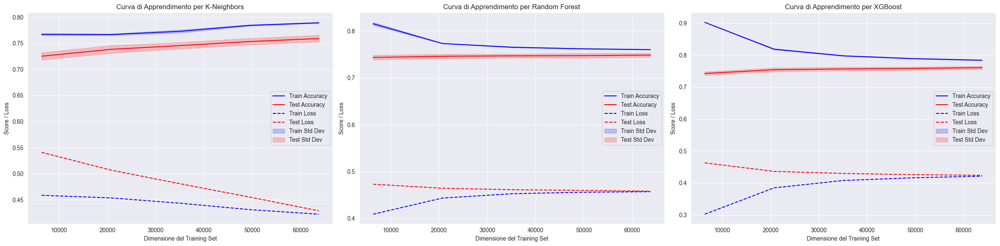

In [130]:
# Traccia le curve di apprendimento
plot_learning_curves(best_models_optimised, X_train, y_train)

Dai risultati ottenuti, possiamo vedere che l'overfitting é stato ridotto con successo in tutti i modelli, con performance molto piú bilanciate tra training e test set, senza perdita eccessiva di Accuracy sul test set.
Nello specifico:
- Il modello **K-Neighbors** ha ottenuto un risultato interessante, con un'Accuracy Score del ~77%, ma con un gap tra training e test set molto piú contenuto. Le curve di apprendimento mostrano che il modello non ha raggiunto ancora il massimo della sua capacità di generalizzazione, infatti potrebbe sicuramente beneficiare di un dataset piú grande. In effetti il K-Neighbours é un modello che basa la sua predizione sulla vicinanza dei dati, quindi piú dati ha a disposizione, piú sará in grado di generalizzare.
- Il modello **Random Forest** ha ottenuto un'Accuracy Score del ~75%, ma ha ridotto di molto il gap tra training e test set. In questo caso, le curve di apprendimento mostrano che il modello ha raggiunto la sua massima capacitá di generalizzazione, con curve di train e test che convergono, mostrando assenza di overfitting.
- Il modello **XGBoost** ha ottenuto risultati simili al Random Forest per quanto riguarda la curva di apprendimento e l'overfitting, con un'Accuracy Score del ~76%, ed é il modello che ha ottenuto il miglior risultato di Precision score, con un valore del ~79%.

In generale, i risultati ottenuti mostrano che la ricerca degli iperparametri ottimizzati ha portato a una riduzione dell'overfitting e a una maggiore capacitá di generalizzazione dei modelli.

## Feature selection
Nel dataset in esame, nonostante la pulizia e il clustering, ci sono ancora molte feature, alcune delle quali potrebbero non contribuire alla predizione del target. 
Utilizziamo la feature selection per:
1. **Identificare le feature più importanti** per il target.
2. **Ridurre la dimensionalità**, eliminando feature non significative.

Per il K-Nearest Neighbors, viene utilizzata la tecnica **SelectKBest**, che seleziona le migliori K feature in base a un test statistico (ANOVA F-Test).
Per il Random Forest e XGBoost, viene utilizzata la tecnica **SelectFromModel**, che seleziona le feature in base all'importanza assegnata direttamente dal modello.

### ANOVA F-Test
L'**ANOVA F-Test** (Analysis of Variance F-Test) è una tecnica statistica che misura quanto una feature è rilevante per predire il target. 

Confronta:
- **Varianza tra i gruppi**: attribuibile alla relazione tra la feature e il target.
- **Varianza intra-gruppo**: attribuibile al rumore o alla variabilità interna ai gruppi.

Il test produce un **F-value** e un **p-value**:
- Un **F-value alto** indica che la varianza tra i gruppi è molto maggiore della varianza intra-gruppo, suggerendo che la feature è rilevante per predire il target.
- Un **P-value basso** (es. < 0.05) indica che la feature ha una relazione statisticamente significativa con il target.


Vediamo quali sono le features piú importanti per i modelli Random Forest e XGBoost.

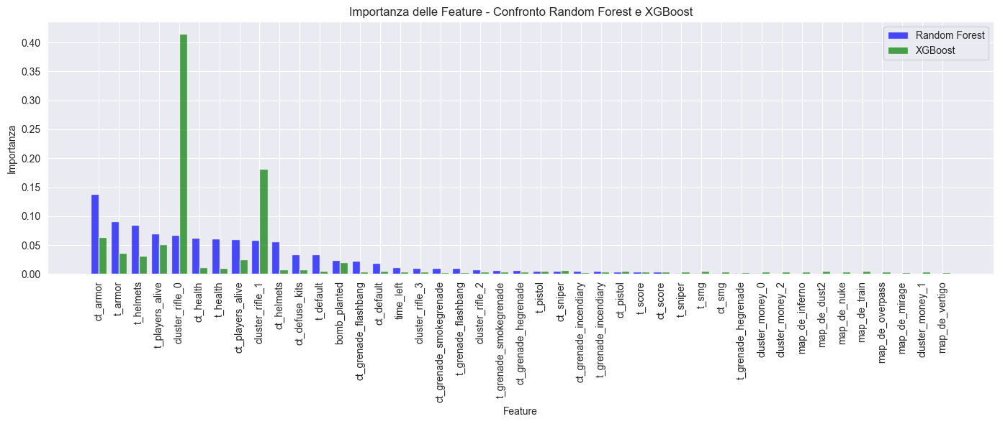

In [162]:
# Importanza delle feature per Random Forest
rf_importances = best_models_optimised['Random Forest'].feature_importances_
rf_indices = np.argsort(rf_importances)[::-1]

# Importanza delle feature per XGBoost
xgb_importances = best_models_optimised['XGBoost'].feature_importances_
xgb_indices = np.argsort(xgb_importances)[::-1]

# Ordine comune delle feature basato su Random Forest
common_indices = rf_indices  # Cambia se preferisci l'ordine di XGBoost

# Recupera nomi delle feature ordinati
feature_names = X.columns[common_indices]

# Recupera le importanze ordinate
rf_sorted = rf_importances[common_indices]
xgb_sorted = xgb_importances[common_indices]

# Crea il plot combinato
x = np.arange(len(feature_names))  # Posizioni delle barre

plt.figure(figsize=(14, 6))
plt.bar(x - 0.2, rf_sorted, width=0.4, label='Random Forest', color='blue', alpha=0.7)
plt.bar(x + 0.2, xgb_sorted, width=0.4, label='XGBoost', color='green', alpha=0.7)

# Configurazione degli assi e delle etichette
plt.title("Importanza delle Feature - Confronto Random Forest e XGBoost")
plt.xticks(x, feature_names, rotation=90)
plt.xlabel("Feature")
plt.ylabel("Importanza")
plt.legend()
plt.tight_layout()
plt.show()

In effetti, non sono molte le features che i due modelli considerano importanti per la predizione del target. Questo ci suggerisce che molte delle features presenti nel dataset **potrebbero** non essere rilevanti per la predizione del target.

Quindi la domanda che ci si é posti é: *questa operazione migliorerá o peggiorerá le performance dei modelli?*

In [180]:
params_bayes_fs = {
    'K-Neighbors': {
        'n_neighbors': (20, 25),
        'metric': ['manhattan'],
        'n_jobs': [-1]
    },
    'Random Forest': {
        'n_estimators': (50, 200),
        'max_depth': (8, 11),  
        'min_samples_split': (10, 20),  
        'min_samples_leaf': (2, 6),  
        'max_features': ['sqrt'],  
        'bootstrap': [True],
        'random_state': [13],
        'n_jobs': [-1]
    },
    'XGBoost': {
        'max_depth': (3, 10),
        'learning_rate': (0.01, 0.025, 0.05, 0.1),
        'n_estimators': (100, 300),
        'colsample_bytree': (0.3, 1.0),
        'subsample': (0.5, 1.0),
        'gamma': (0, 10),
        'min_child_weight': (1, 10),
        'reg_lambda': (0, 10),
        'reg_alpha': (0, 10),
        'random_state': [13],
        'n_jobs': [-1]
    }
}

In [171]:
%%capture --no-stdout

# Seleziona le migliori 10 caratteristiche
selector_knn = SelectKBest(k=10)
X_train_selected_knn = selector_knn.fit_transform(X_train, y_train)
X_test_selected_knn = selector_knn.transform(X_test)

# Stampa le feature selezionate
selected_features = X.columns[selector_knn.get_support()]

print("Feature Selezionate:")
print(selected_features)

best_model_fs_knn = hyperparameter_search({'K-Neighbors': models['K-Neighbors']}, {'K-Neighbors': params_bayes_fs['K-Neighbors']}, X_train_selected_knn, y_train, method="bayes", scoring='accuracy')

Feature Selezionate:
Index(['ct_armor', 't_armor', 'ct_helmets', 't_helmets', 'ct_defuse_kits',
       'ct_players_alive', 'ct_grenade_flashbang', 'ct_default',
       'cluster_rifle_0', 'cluster_rifle_1'],
      dtype='object')
Ricerca degli iperparametri per K-Neighbors (bayes)
Iperparametri migliori per K-Neighbors: OrderedDict({'metric': 'manhattan', 'n_jobs': -1, 'n_neighbors': 25})
Best accuracy: 0.7385



In [174]:
%%capture --no-stdout

# Seleziona le migliori 10 caratteristiche in base all'importanza delle features del modello ottimizzato random forest
selector_rf = SelectFromModel(best_models_optimised['Random Forest'], max_features=10)
X_train_selected_rf = selector_rf.fit_transform(X_train, y_train)
X_test_selected_rf = selector_rf.transform(X_test)

# Stampa le feature selezionate
selected_features = X.columns[selector_rf.get_support()]

print("Feature Selezionate:")
print(selected_features)

best_model_fs_rf = hyperparameter_search({'Random Forest': models['Random Forest']}, {'Random Forest': params_bayes_fs['Random Forest']}, X_train_selected_rf, y_train, method="bayes", scoring='accuracy')

Feature Selezionate:
Index(['ct_health', 't_health', 'ct_armor', 't_armor', 'ct_helmets',
       't_helmets', 'ct_players_alive', 't_players_alive', 'cluster_rifle_0',
       'cluster_rifle_1'],
      dtype='object')
Ricerca degli iperparametri per Random Forest (bayes)
Iperparametri migliori per Random Forest: OrderedDict({'bootstrap': True, 'max_depth': 11, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 10, 'n_estimators': 170, 'n_jobs': -1, 'random_state': 13})
Best accuracy: 0.7468



In [181]:
%%capture --no-stdout

# Seleziona le migliori 10 caratteristiche in base all'importanza delle features del modello ottimizzato XGBoost
selector_xgb = SelectFromModel(best_models_optimised['XGBoost'], max_features=10)
X_train_selected_xgb = selector_xgb.fit_transform(X_train, y_train)
X_test_selected_xgb = selector_xgb.transform(X_test)

# Stampa le feature selezionate
selected_features = X.columns[selector_xgb.get_support()]

print("Feature Selezionate:")
print(selected_features)

best_model_fs_xgb = hyperparameter_search({'XGBoost': models['XGBoost']}, {'XGBoost': params_bayes_fs['XGBoost']}, X_train_selected_xgb, y_train, method="bayes", scoring='accuracy')

Feature Selezionate:
Index(['ct_armor', 't_armor', 't_helmets', 'ct_players_alive',
       't_players_alive', 'cluster_rifle_0', 'cluster_rifle_1'],
      dtype='object')
Ricerca degli iperparametri per XGBoost (bayes)
Iperparametri migliori per XGBoost: OrderedDict({'colsample_bytree': 0.9470144239993561, 'gamma': 0, 'learning_rate': 0.01, 'max_depth': 9, 'min_child_weight': 10, 'n_estimators': 138, 'n_jobs': -1, 'random_state': 13, 'reg_alpha': 4, 'reg_lambda': 10, 'subsample': 0.9817797076805734})
Best accuracy: 0.7354



In [182]:
%%capture --no-stdout

# Valutazione dei modelli
score_test_fs_knn, score_train_fs_knn = evaluate_models(best_model_fs_knn, X_train_selected_knn, y_train, X_test_selected_knn, y_test)
score_test_fs_rf, score_train_fs_rf = evaluate_models(best_model_fs_rf, X_train_selected_rf, y_train, X_test_selected_rf, y_test)
score_test_fs_xgb, score_train_fs_xgb = evaluate_models(best_model_fs_xgb, X_train_selected_xgb, y_train, X_test_selected_xgb, y_test)


Addestramento e valutazione per il modello: K-Neighbors

Matrice di Confusione - K-Neighbors (Test):
[[6351 2147]
 [2457 6761]]

Matrice di Confusione - K-Neighbors (Train):
[[26219  7874]
 [ 8990 27778]]

Metriche sul Test Set:
              Modello  Recall  Precision  F1 Score  Accuracy
0  K-Neighbors (Test) 0.73346    0.75898   0.74600   0.74012

Metriche sul Training Set:
               Modello  Recall  Precision  F1 Score  Accuracy
0  K-Neighbors (Train) 0.75549    0.77914   0.76714   0.76201

Addestramento e valutazione per il modello: Random Forest

Matrice di Confusione - Random Forest (Test):
[[6512 1986]
 [2475 6743]]

Matrice di Confusione - Random Forest (Train):
[[26688  7405]
 [ 9440 27328]]

Metriche sul Test Set:
                Modello  Recall  Precision  F1 Score  Accuracy
0  Random Forest (Test) 0.73150    0.77248   0.75143   0.74819

Metriche sul Training Set:
                 Modello  Recall  Precision  F1 Score  Accuracy
0  Random Forest (Train) 0.74326    0.7868

Calcolo delle curve di apprendimento per K-Neighbors


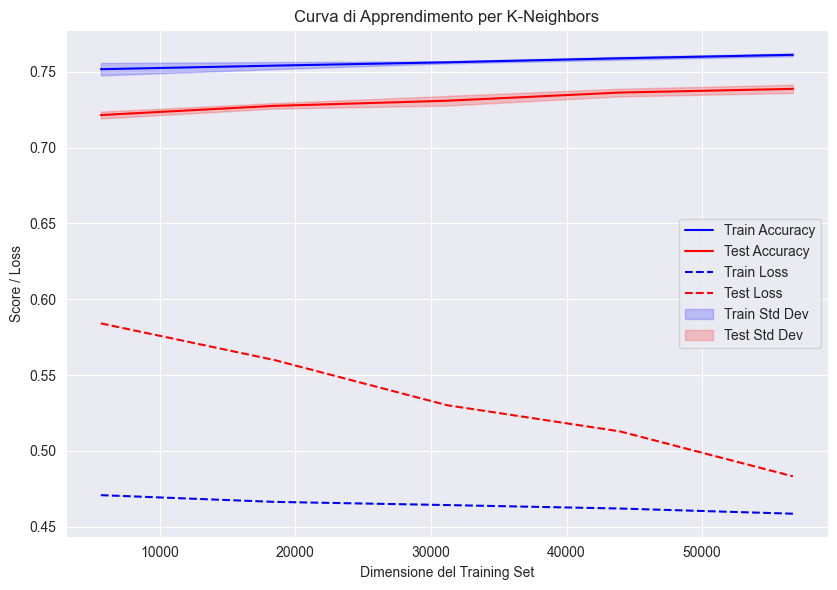

Calcolo delle curve di apprendimento per Random Forest


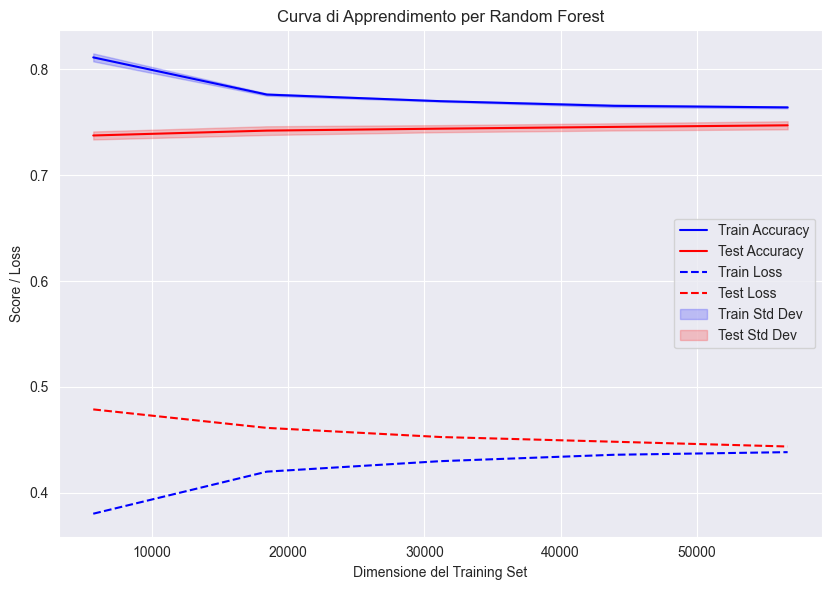

Calcolo delle curve di apprendimento per XGBoost


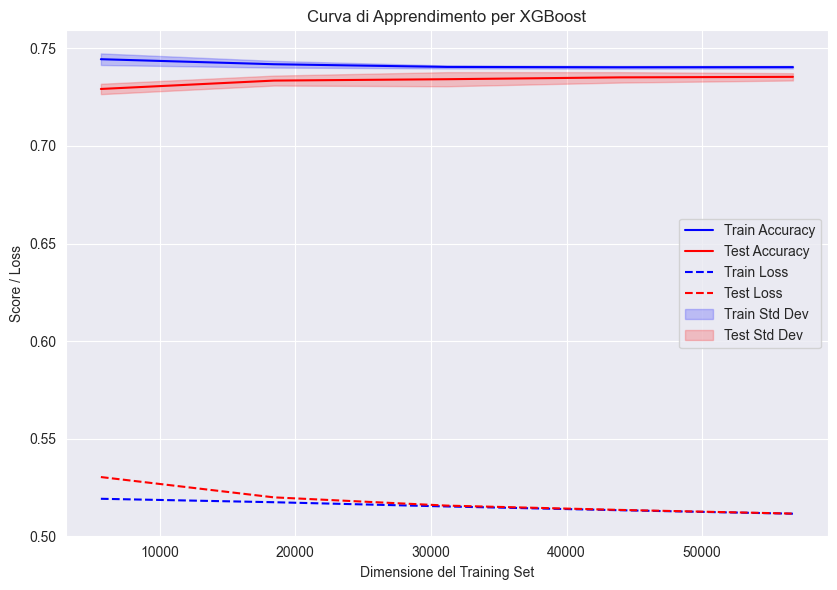

In [183]:
# Traccia le curve di apprendimento
plot_learning_curves(best_model_fs_knn, X_train_selected_knn, y_train)
plot_learning_curves(best_model_fs_rf, X_train_selected_rf, y_train)
plot_learning_curves(best_model_fs_xgb, X_train_selected_xgb, y_train)

In [195]:
categories = ['First', 'Optimised', 'Feature Selected']

score_test_fs = compare_models(score_test_fs_knn, score_test_fs_rf, score_test_fs_xgb)
score_train_fs = compare_models(score_train_fs_knn, score_train_fs_rf, score_train_fs_xgb)

combined_scores_test = compare_models(score_test_first, score_test_optimised, score_test_fs, categories=categories)
combined_scores_train = compare_models(score_train_first, score_train_optimised, score_train_fs, categories=categories)

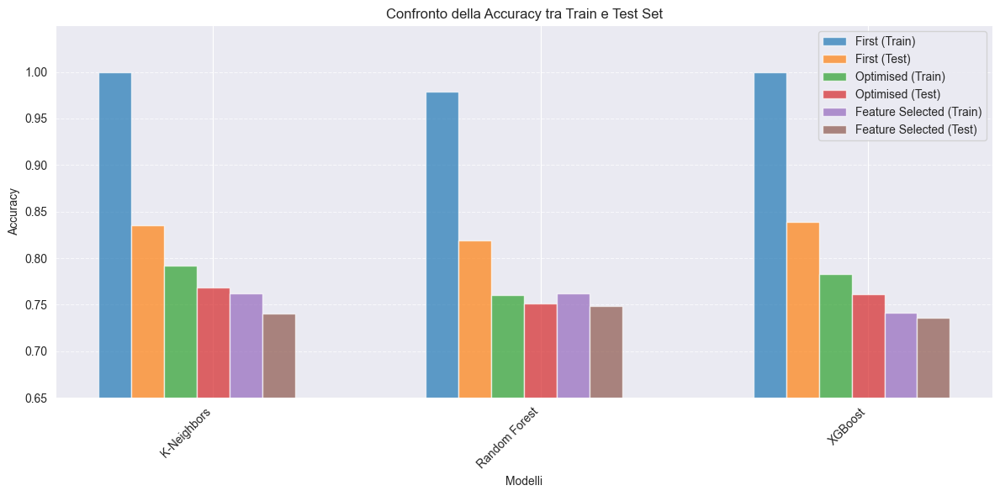

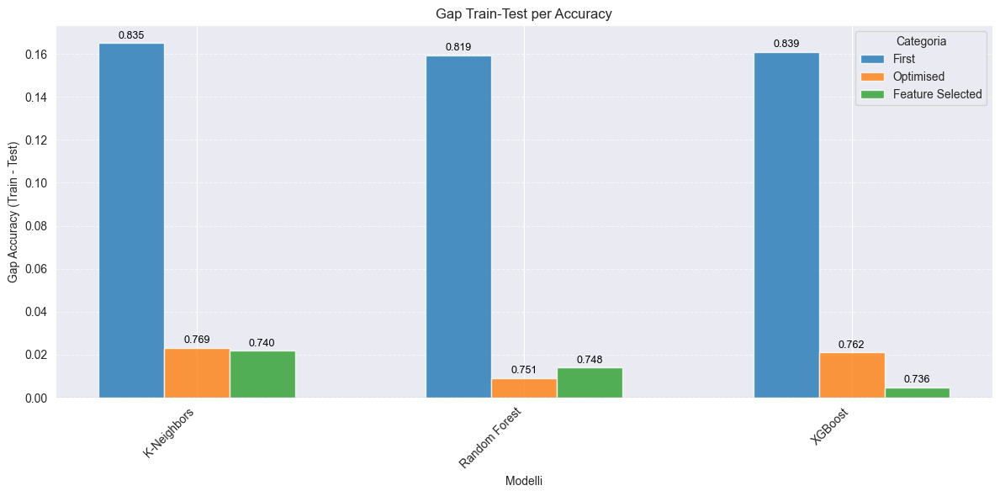

In [196]:
plot_histogram_comparison(combined_scores_train, combined_scores_test, 'Accuracy')

# Traccia il gap tra Train Set e Test Set, su ogni modello testato, sulla metrica Accuracy
# Su ogni barra é indicato il valore dell'Accuracy sul Test Set

plot_train_test_gap(combined_scores_train, combined_scores_test, 'Accuracy')

Dai risultati ottenuti, al contrario delle aspettative, possiamo vedere che la selezione delle feature ha portato a un peggioramento generale delle performance dei modelli. Questo potrebbe significare che la maggior parte delle feature nel dataset sono in realtá rilevanti per la predizione del target, e che la rimozione di alcune di esse potrebbe portare a una perdita di informazioni importanti per i modelli.

In conclusione, i modelli ottimizzati hanno ottenuto i migliori risultati, con un buon bilanciamento tra training e test set, senza grandi segni di overfitting.